# REMOVE D0017

## Libraries

In [1]:
import numpy as np
import scipy
from scipy import sparse
from scipy.sparse import csr_matrix
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import anndata as ad
import glob
import sys
#import scvi
import gc
import re
import cytopus as cp
import Spectra
import gseapy as gp
import statsmodels.api as sm
import statsmodels.formula.api as smf

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Site and health information

In [2]:
sample_info_raw = pd.read_csv("/project/tishkofflab/data/Electronic_Field_Data/2024/2024_freeze_3/TishkoffLab/Collection_Demographics/Subject_Data.TishkoffLab.Collection_Demographics.2024_freeze_3.utf8.txt", sep="\t")
pheno_info_raw = pd.read_csv("/project/tishkofflab/data/Electronic_Field_Data/2024/2024_freeze_3/A6K/Phenotypes/Subject_Data.A6K.BRONZE.Phenotypes.2024_freeze_3.utf8.txt", sep="\t")
pheno_diab_raw = pd.read_csv("/project/tishkofflab/projects/danihar_biomarker_project/olink/data/phenotypes/v1/DF_step2.txt", sep="\t")
pathogens = pd.read_csv("../../sample_info/Cameroon_PathogenResults_Chao.csv").rename(columns={'Field ID': 'FID'})
rna_path = pd.read_csv("../../sample_info/2024_08_19_parasite_scan_scRNA_samples.csv").rename(columns={'field_ID': 'FID'})

/tmp/ipykernel_83197/3845627791.py:1: DtypeWarning: Columns (4,5,6,9,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,52,53,54,55,56,57,58,59,60,61,62,63,64,65,67,68,69,71,72,74,75,77,78,80,81,83,84,86,87,89,90,92,93,95,96,98,99,101,102,104,105,107,108,110,111,113,114,116,117,119,120,122,123,125,126,128,129,130,131,132,133,134,135,136,165,166,167,168,169,170,171,172,173,174,175,176,177,180,181,182,183,185,187,189,191,192,193,194,195,196,197,198,199,200,201,202,203,204) have mixed types. Specify dtype option on import or set low_memory=False.
  sample_info_raw = pd.read_csv("/project/tishkofflab/data/Electronic_Field_Data/2024/2024_freeze_3/TishkoffLab/Collection_Demographics/Subject_Data.TishkoffLab.Collection_Demographics.2024_freeze_3.utf8.txt", sep="\t")
/tmp/ipykernel_83197/3845627791.py:2: DtypeWarning: Columns (4,5,6,10,12,73,74,108) have mixed types. Specify dtype option on import or set low_memory=False.
  pheno_info_raw = pd

In [3]:
site_collect = sample_info_raw[['ID:topmed',
                                'ID:field',
                                'Subject_Information:Ethnicity::str',
                                'Collection_Information:Latitude::num::deg',
                                'Collection_Information:Longitude::num::deg',
                                'Collection_Information:Site::str',
                                'Collection_Information:Date::date',
                                'Categorization:Lifestyle:Subsistence_Practice::str',
                                'Categorization:Lifestyle:Subsistence_Practice:Notes::str']]

site_collect = site_collect.rename(columns={'ID:topmed': 'TID',
                                            'ID:field': 'FID',
                                            'Subject_Information:Ethnicity::str': 'Ethnicity',
                                            'Collection_Information:Latitude::num::deg': 'latitude',
                                            'Collection_Information:Longitude::num::deg': 'longitude',
                                            'Collection_Information:Site::str': 'site',
                                            'Collection_Information:Date::date': 'date',
                                            'Categorization:Lifestyle:Subsistence_Practice::str': 'subsistence'})

In [4]:
pheno = pheno_info_raw[['ID:topmed',
                        'Subject_Measurement:Cardiovascular:Blood_Pressure_Systolic:Mean::num::Hgmm',
                        'Subject_Measurement:Cardiovascular:Blood_Pressure_Diastolic:Mean::num::Hgmm',
                        'Subject_Measurement:Anthropometric:BMI::num',
                        'Subject_Measurement:Anthropometric:Body_Fat_Percentage::num::frac']] \
    .rename(columns={'ID:topmed': 'TID',
                     'Subject_Measurement:Cardiovascular:Blood_Pressure_Systolic:Mean::num::Hgmm': 'bp_systolic',
                     'Subject_Measurement:Cardiovascular:Blood_Pressure_Diastolic:Mean::num::Hgmm': 'bp_diastolic',
                     'Subject_Measurement:Anthropometric:BMI::num': 'BMI',
                     'Subject_Measurement:Anthropometric:Body_Fat_Percentage::num::frac': 'bf_pct'})

pheno = pheno_diab_raw[['ID:topmed',
                        'Biospecimen_Measurement:Blood:Glucose:Mean::num::mg/dL',
                        'Hypertension',
                        'Hypertension_bool',
                        'Diabetes',
                        'Subject_Information:Medical:Fasting:bool']] \
    .rename(columns={'ID:topmed': 'TID',
                     'Biospecimen_Measurement:Blood:Glucose:Mean::num::mg/dL': 'blood_glucose',
                     'Subject_Information:Medical:Fasting:bool': 'fasting_bool'}) \
    .merge(pheno, how="right")

## Functions

In [5]:
def harmonize_str(x):

    return(x.replace(" ", "_").replace("+", "pos").replace("-", "neg").replace("/", "_"))

In [6]:
def grouped_obs_sum(adata, group_key, layer=None, gene_symbols=None):
    if layer is not None:
        getX = lambda x: x.layers[layer]
    else:
        getX = lambda x: x.X
    if gene_symbols is not None:
        new_idx = adata.var[idx]
    else:
        new_idx = adata.var_names

    grouped = adata.obs.groupby(group_key)
    out = pd.DataFrame(
        np.zeros((adata.shape[1], len(grouped)), dtype=np.float64),
        columns=list(grouped.groups.keys()),
        index=adata.var_names
    )

    for group, idx in grouped.indices.items():
        X = getX(adata[idx])
        out[group] = np.ravel(X.sum(axis=0, dtype=np.float64))
    return out

In [7]:
def grouped_obs_mean(adata, group_key, layer=None, gene_symbols=None):
    if layer is not None:
        getX = lambda x: x.layers[layer]
    else:
        getX = lambda x: x.X
    if gene_symbols is not None:
        new_idx = adata.var[idx]
    else:
        new_idx = adata.var_names

    grouped = adata.obs.groupby(group_key)
    out = pd.DataFrame(
        np.zeros((adata.shape[1], len(grouped)), dtype=np.float64),
        columns=list(grouped.groups.keys()),
        index=adata.var_names
    )

    for group, idx in grouped.indices.items():
        X = getX(adata[idx])
        out[group] = np.ravel(X.mean(axis=0, dtype=np.float64))
    return out

## Main

In [8]:
counts_f = "../../test/test123/write/qc_020725_raw.h5ad"

In [9]:
adata = sc.read_h5ad(counts_f, backed='r')

In [10]:
spectra = sc.read_h5ad('../../test/test123/write/qc_020725.spectra_out.4k.h5ad', backed='r')

In [11]:
umap = sc.read_h5ad("../../test/test123/write/qc_020725_wctypes.harmony.umap.h5ad", backed='r')

In [12]:
adata.uns = spectra[adata.obs_names].uns
adata.obsm = spectra[adata.obs_names].obsm

In [13]:
adata.obsm['X_umap'] = umap[adata.obs_names].obsm['X_umap']

In [14]:
del spectra
del umap
gc.collect()

20

In [15]:
ct_map = {'B cells': 'B',
          'CD4+ T cells': 'CD4T',
          'DN T cells': 'DNT',
          'MAIT cells': 'MAIT',
          'Myeloid cells': 'Myeloid',
          'NK cells': 'NK',
          'Progenitor cells': 'Progenitor',
          'TRAV1-2- CD8+ T cells': 'CD8T',
          'gd T cells': 'gdT'}

In [16]:
# clean up cell types
ctypes = pd.read_csv("../../sample_info/celltype_map.022125.csv")
ctype_dict = dict(zip(ctypes['Tier_1'] + ":" + ctypes['Tier_3'], 
                      ctypes['Tier_1'].apply(lambda x: ct_map[x]) + "," + ctypes['Tier_2'].apply(lambda x: harmonize_str(str(x)))))
adata.obs['ct2'] = adata.obs['FCluster_names'].apply(lambda x: ctype_dict[x])

### Re-cluster control monocytes and create scores

I am going to re-cluster on the genes selected by Spectra

In [17]:
scores_df = pd.DataFrame(adata.obsm['SPECTRA_cell_scores'], index=adata.obs.index, columns=adata.uns['SPECTRA_overlap'].index)

In [18]:
adata.obs[scores_df.columns] = scores_df.loc[adata.obs_names,:]

In [19]:
adata_m = adata[adata.obs['cytopus_names']=="M"].to_memory()
adata_m = adata_m[~(adata_m.obs['FID']=="D0017")]

In [20]:
adata_cm = adata_m[adata_m.obs['COND']=="CTL"]

In [21]:
adata_lm = adata_m[adata_m.obs['COND']=="LPS"]

In [22]:
sc.pp.normalize_total(adata_cm)
sc.pp.log1p(adata_cm)

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:206: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [23]:
adata_cm = adata_cm[:,adata_cm.uns['SPECTRA_markers'][24]]

In [24]:
sc.tl.pca(adata_cm)

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/scanpy/preprocessing/_pca.py:314: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm["X_pca"] = X_pca


In [26]:
sc.pp.neighbors(adata_cm)

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-pac

In [27]:
sc.tl.umap(adata_cm)

In [28]:
sc.tl.leiden(adata_cm, flavor="igraph", n_iterations=2)

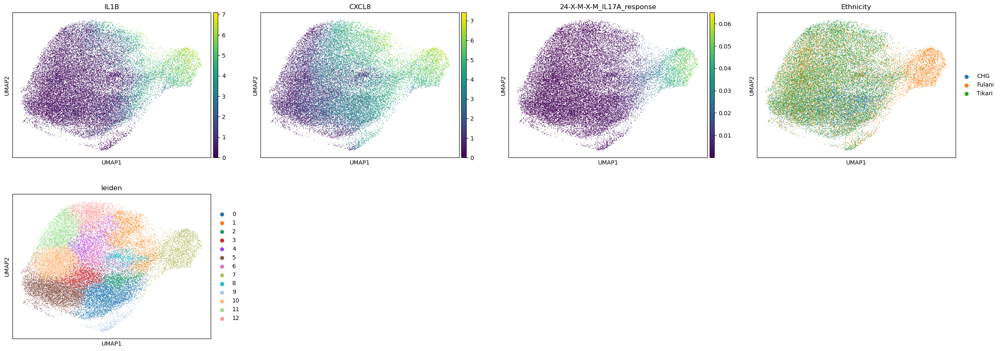

In [29]:
sc.pl.umap(adata_cm, color=['IL1B','CXCL8','24-X-M-X-M_IL17A_response','Ethnicity','leiden'])

In [30]:
cm_means = grouped_obs_mean(adata_cm, 'FID', layer=None, gene_symbols=None)

In [31]:
il1b_cm = cm_means.transpose()['IL1B'].reset_index().rename(columns={'index': 'FID'})

In [32]:
f24_frac = pd.DataFrame({'FID': adata_cm.obs['FID'], 'inscore': adata_cm.obs['leiden']=="11"}) \
    .groupby('FID')['inscore'].mean().reset_index()

In [33]:
f24_frac.to_csv("misc/inscore_FID.csv", index=False)

In [34]:
scores_means = scores_df.merge(adata.obs[['FID','COND','cytopus_names']], left_index=True, right_index=True) \
    .groupby(['FID','COND','cytopus_names']).mean().reset_index() \
    .merge(adata.obs[['FID','AGE','SEX','Ethnicity']].drop_duplicates())

In [35]:
scores_means = scores_means.merge(f24_frac)

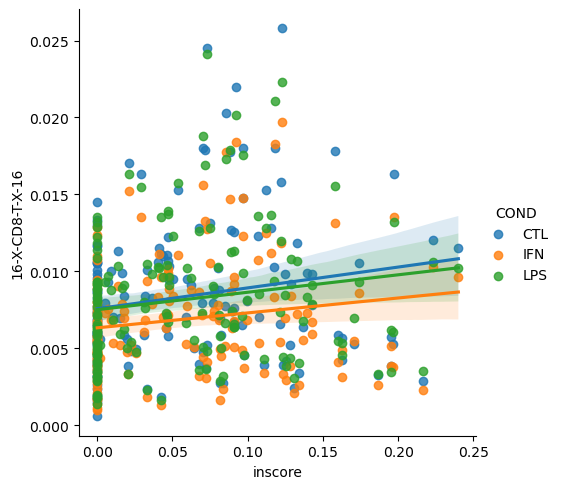

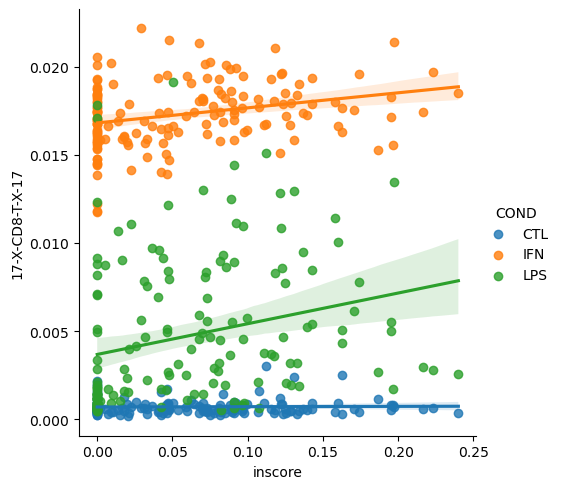

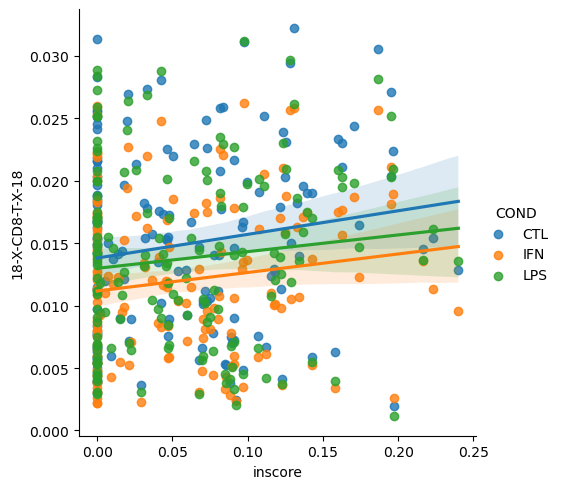

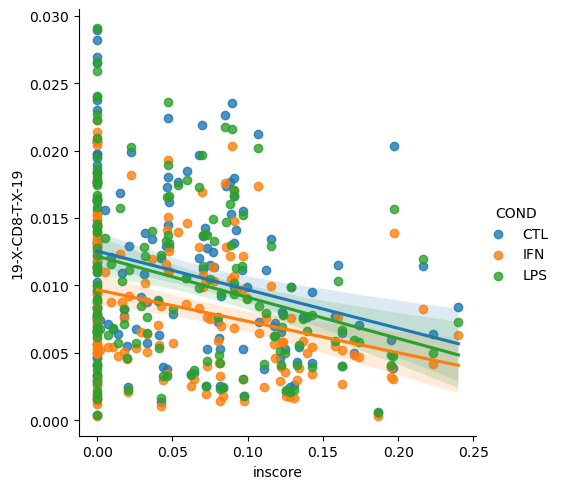

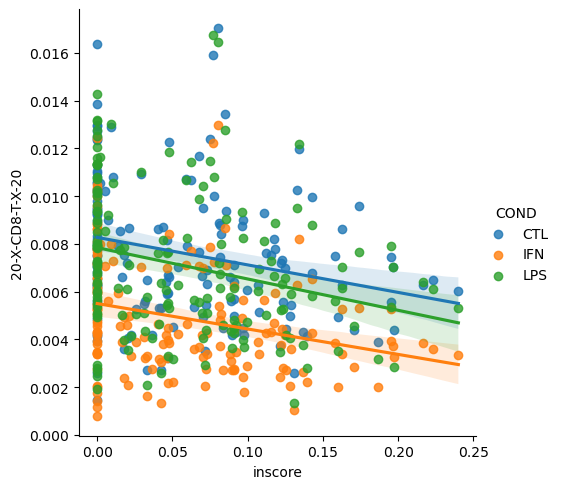

In [36]:
for factor in ['16-X-CD8-T-X-16',
       '17-X-CD8-T-X-17', '18-X-CD8-T-X-18', '19-X-CD8-T-X-19',
       '20-X-CD8-T-X-20']:
    
    sns.lmplot(scores_means[scores_means['cytopus_names']=="CD8-T"], x='inscore', y=factor, hue='COND')
    plt.show()

In [73]:
scores_means.columns

Index(['FID', 'COND', 'cytopus_names', '0-X-global-X-0', '1-X-global-X-1',
       '2-X-global-X-2', '3-X-B-X-3', '4-X-B-X-4', '5-X-B-X-5', '6-X-B-X-6',
       '7-X-B-X-7', '8-X-CD4-T-X-8', '9-X-CD4-T-X-9', '10-X-CD4-T-X-10',
       '11-X-CD4-T-X-11', '12-X-CD4-T-X-12', '13-X-CD4-T-X-13',
       '14-X-CD4-T-X-14', '15-X-CD4-T-X-15', '16-X-CD8-T-X-16',
       '17-X-CD8-T-X-17', '18-X-CD8-T-X-18', '19-X-CD8-T-X-19',
       '20-X-CD8-T-X-20', '21-X-DNT-X-21', '22-X-M-X-M_IL17A_response',
       '23-X-M-X-23', '24-X-M-X-M_IL17A_response', '25-X-M-X-25',
       '26-X-M-X-DC_antigen-crosspresentation', '27-X-M-X-27',
       '28-X-M-X-DC_antigen-crosspresentation', '29-X-M-X-M_IL17A_response',
       '30-X-M-X-neutro_CXCL8_response', '31-X-M-X-31', '32-X-M-X-32',
       '33-X-M-X-Mac_IL4-IL13_response', '34-X-M-X-34', '35-X-M-X-35',
       '36-X-MAIT-X-36', '37-X-NK-X-37', '38-X-NK-X-38',
       '39-X-Progenitor-X-39', '40-X-gdT-X-40', 'AGE', 'SEX', 'Ethnicity',
       'inscore'],
      dtype=

In [41]:
adata_lm = adata_m[adata_m.obs['COND']=="LPS"]
sc.pp.normalize_total(adata_lm)
sc.pp.log1p(adata_lm)
adata_lm = adata_lm[:,adata_lm.uns['SPECTRA_markers'][24]]
lm_means = grouped_obs_mean(adata_lm, 'FID', layer=None, gene_symbols=None)

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:206: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [35]:
il1b_lm = lm_means.transpose()['IL1B'].reset_index().rename(columns={'index': 'FID', 'IL1B': 'IL1B_LPS'})

In [36]:
def get_ifit3_df(ctype, gene):

    adata_tmp = adata[adata.obs['cytopus_names']==ctype].to_memory()

    sc.pp.normalize_total(adata_tmp)
    sc.pp.log1p(adata_tmp)

    means = grouped_obs_mean(adata_tmp, ['FID','COND'], layer=None, gene_symbols=None).transpose()

    means.index = pd.MultiIndex.from_tuples(means.index)
    means = means.reset_index().rename(columns={'level_0': 'FID', 'level_1': 'COND'})

    ifit3 = means[['FID','COND',gene]].pivot(index='FID', columns='COND', values=gene).reset_index().merge(f24_frac)
    ifit3 = ifit3.merge(adata.obs[['FID','Ethnicity']].drop_duplicates())
    ifit3['Ethnicity'] = pd.Categorical(ifit3['Ethnicity'], categories=['Tikari','Fulani','CHG'])
    ifit3 = ifit3.merge(il1b_cm)
    ifit3 = ifit3.merge(pathogens)
    ifit3 = ifit3.merge(site_collect[['FID','site','date']])
    ifit3 = ifit3.merge(adata.obs[['FID','SEX','AGE']].drop_duplicates())
    ifit3 = ifit3.merge(rna_path[['FID','P.f.nm0']])

    return(ifit3)

In [273]:
ifit3_cd4t = get_ifit3_df('CD4-T','IFIT3')

In [291]:
ifit3_cd8t = get_ifit3_df('CD8-T', 'IFIT3')

In [286]:
ifit3_nk = get_ifit3_df('NK', 'IFIT3')

In [309]:
ifit3_b = get_ifit3_df('B', 'IFIT3')

In [306]:
ifit3_m = get_ifit3_df('M', 'IFIT3')

In [311]:
il1b_m = get_ifit3_df('M', 'IL1B')

In [321]:
ifit3_gdt = get_ifit3_df('gdT', 'IFIT3')

In [325]:
ifit3_mait = get_ifit3_df('MAIT', 'IFIT3')

In [326]:
ifit3_dnt = get_ifit3_df('DNT', 'IFIT3')

In [ ]:
ifit3_cd4t.to_csv("./output/ifit3_cd4t.csv")
ifit3_cd8t.to_csv("./output/ifit3_cd8t.csv")
ifit3_nk.to_csv("./output/ifit3_nk.csv")
ifit3_m.to_csv("./output/ifit3_m.csv")
il1b_m.to_csv("./output/il1b_m.csv")
ifit3_gdt.to_csv("./output/ifit3_gdt.csv")
ifit3_mait.to_csv("./output/ifit3_mait.csv")
ifit3_dnt.to_csv("./output/ifit3_dnt.csv")

In [37]:
ifit3_cd4t = pd.read_csv("./output/ifit3_cd4t.csv")
ifit3_m = pd.read_csv("./output/ifit3_m.csv")

In [41]:
ifit3_cd4t = ifit3_cd4t[~(ifit3_cd4t['FID']=="D0017")]
ifit3_cd4t['Ethnicity'] = pd.Categorical(ifit3_cd4t['Ethnicity'], categories=['Tikari','Fulani','CHG'])

In [49]:
adata.obs['weird_fids'] = adata.obs['FID'].isin(weird_fids)

In [52]:
adata_weird = adata[adata.obs['weird_fids']].to_memory()

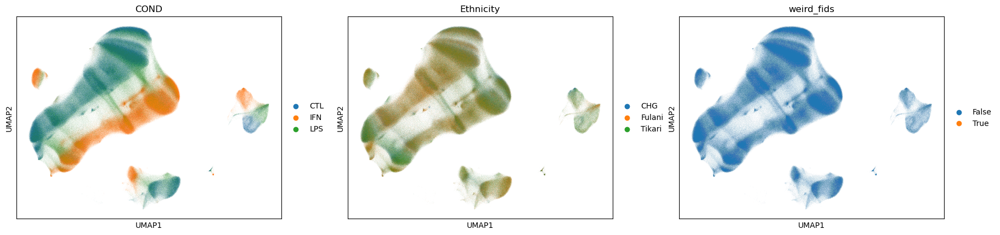

In [51]:
sc.pl.umap(adata, color=['COND','Ethnicity','weird_fids'])

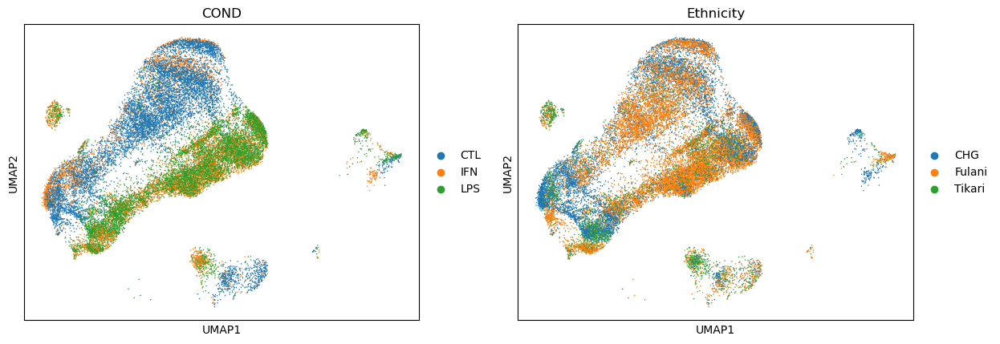

In [53]:
sc.pl.umap(adata_weird, color=['COND','Ethnicity'])

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


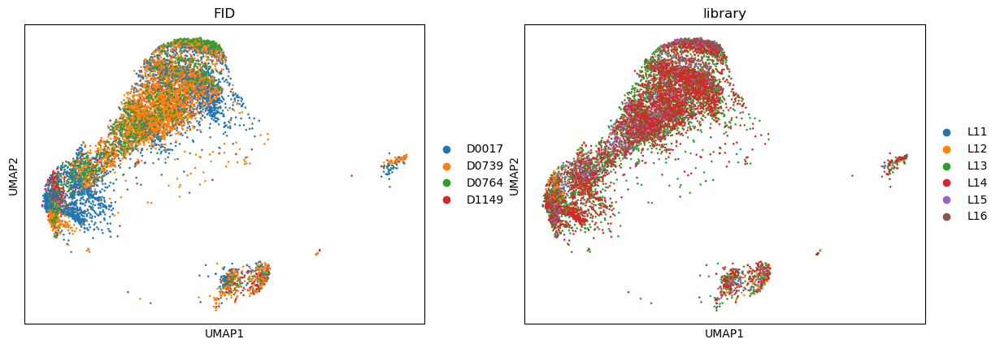

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


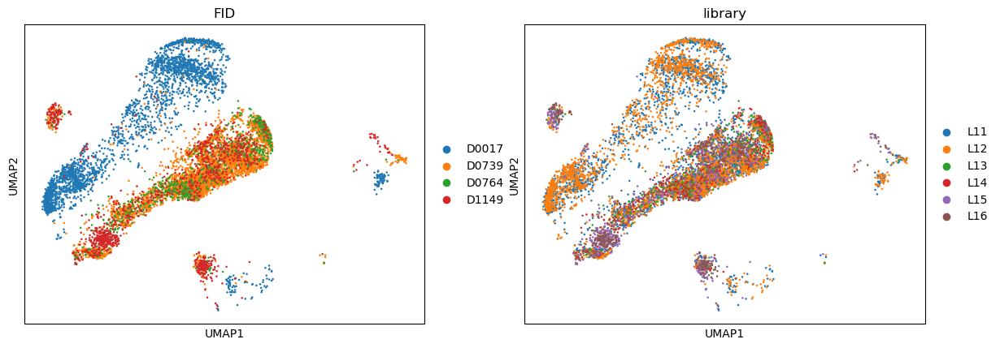

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


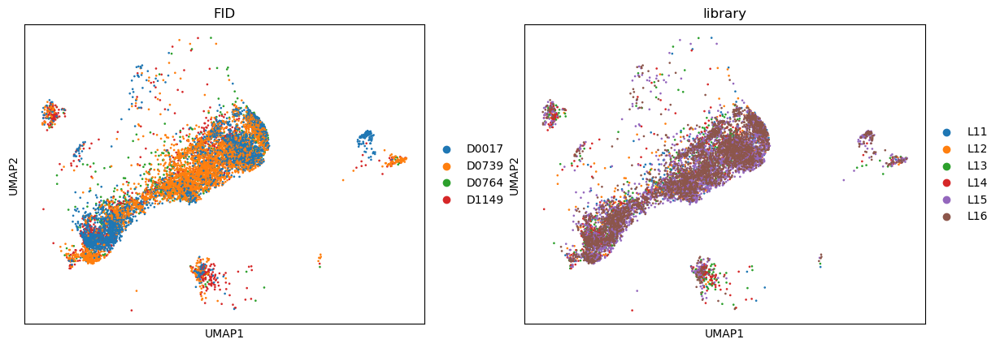

In [63]:
sc.pl.umap(adata_weird[adata_weird.obs['COND']=="CTL"], color=['FID','library'])
sc.pl.umap(adata_weird[adata_weird.obs['COND']=="IFN"], color=['FID','library'])
sc.pl.umap(adata_weird[adata_weird.obs['COND']=="LPS"], color=['FID','library'])

<Axes: xlabel='inscore', ylabel='9-X-CD4-T-X-9'>

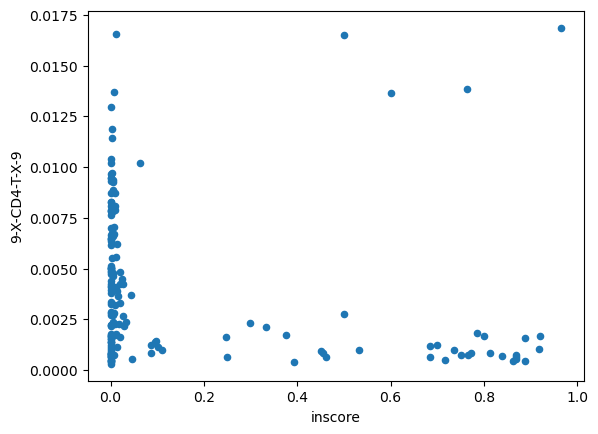

In [43]:
foo = scores_means[(scores_means['cytopus_names']=="CD4-T") & \
    (scores_means['COND']=="LPS")].merge(f24_frac)[['inscore','9-X-CD4-T-X-9']].plot.scatter(x='inscore', y='9-X-CD4-T-X-9')

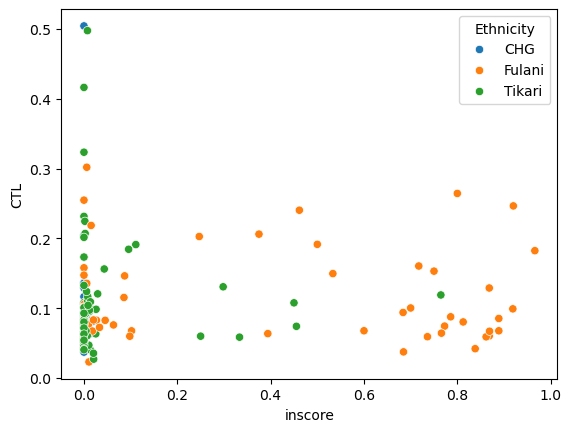

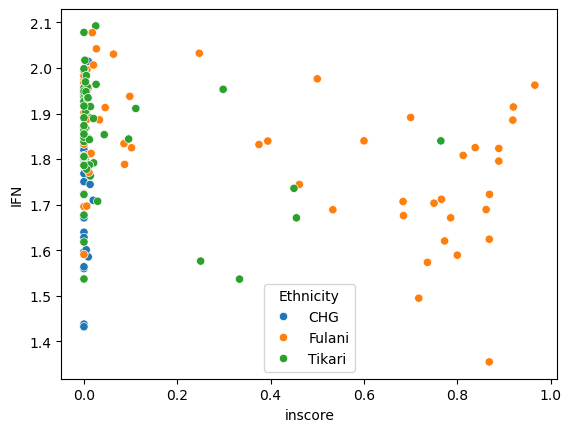

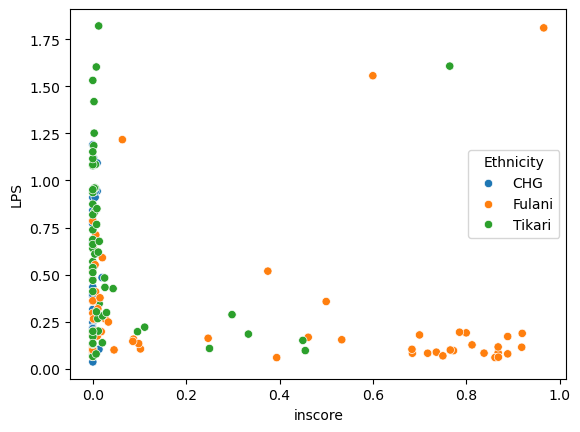

In [40]:
sns.scatterplot(x = ifit3_cd4t['inscore'], y=ifit3_cd4t['CTL'], hue=ifit3_cd4t['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_cd4t['inscore'], y=ifit3_cd4t['IFN'], hue=ifit3_cd4t['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_cd4t['inscore'], y=ifit3_cd4t['LPS'], hue=ifit3_cd4t['Ethnicity'])
plt.show()

In [62]:
cm_counts = adata_cm.obs['FID'].value_counts().reset_index().rename(columns={'FID': 'count', 'index':'FID'})

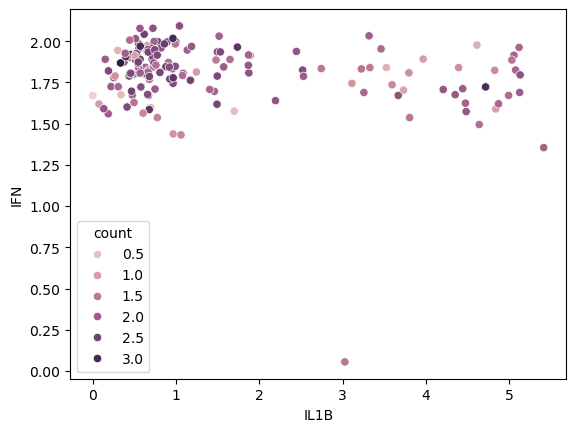

In [68]:
ifit3_cd4t = ifit3_cd4t.merge(cm_counts)
sns.scatterplot(x = ifit3_cd4t['IL1B'], y=ifit3_cd4t['IFN'], hue=np.log10(ifit3_cd4t['count']))
plt.show()

In [43]:
weird_fids = ifit3_cd4t[(ifit3_cd4t['inscore'] > 0.4) & (ifit3_cd4t['LPS'] > 1.25)]['FID']

In [53]:
adata_cm[adata_cm.obs['FID'].isin(weird_fids)].shape

(117, 50)

In [60]:
adata.obs[adata.obs['library']=="L11"][['FID','donor_id','library']].drop_duplicates()

,FID,donor_id,library
index,,,
GAACGTTAGTGAGTGC-1_L11,D0776,NWD906822,L11
CCTATCGTCCAGCCTT-1_L11,D1149,NWD950337,L11
GTGAGCCCATATGAAG-1_L11,D0138,NWD788849,L11
CGCATAAGTCAACCTA-1_L11,D1342,NWD945485,L11
CATTTCACACAAACGG-1_L11,D0764,NWD902870,L11
GTGCACGTCGGAGCAA-1_L11,D0739,NWD528158,L11
ATGACCAGTCACGTGC-1_L11,D0017,donor6,L11


In [59]:
adata.obs[adata.obs['FID'].isin(weird_fids) & (adata.obs['COND']=="IFN")][['FID','donor_id','library']].drop_duplicates()

,FID,donor_id,library
index,,,
GTGCACGTCGGAGCAA-1_L11,D0739,NWD528158,L11
ATGACCAGTCACGTGC-1_L11,D0017,donor6,L11
GGTAGAGTCTGCTCTG-1_L12,D0017,donor7,L12
GGGTGTCAGGATTTGA-1_L12,D0739,NWD528158,L12
CAAGCTAGTACACGCC-1_L13,D0764,NWD902870,L13
TGACGCGCATGACGAG-1_L14,D0764,NWD902870,L14
GTCAGCGTCAACTCTT-1_L15,D1149,NWD950337,L15
ACCAACAGTGGACAGT-1_L16,D1149,NWD950337,L16


In [51]:
foo = adata.obs[adata.obs['FID'].isin(['D0017','D0739','D0764','D1149'])].groupby(['FID','COND']).size()

In [57]:
adata.obs.groupby(['FID','COND']).size().sort_values().head(50)

FID    COND
D0138  LPS      548
       CTL      599
       IFN      624
D0764  CTL      755
D0167  CTL      781
D0764  IFN      785
       LPS      800
D0185  CTL      893
D0167  LPS      907
D0185  IFN     1054
D0167  IFN     1071
D1149  IFN     1151
D0156  CTL     1238
D1149  CTL     1252
       LPS     1254
D0185  LPS     1364
D0019  IFN     1534
D0099  IFN     1565
D0189  LPS     1620
D0187  CTL     1632
D0156  LPS     1655
D0778  IFN     1742
D0121  LPS     1768
       IFN     1774
       CTL     1854
D0160  IFN     1862
D0157  CTL     1977
D0154  CTL     1991
D0160  CTL     1994
D0189  CTL     2072
D0156  IFN     2072
D1145  LPS     2098
D1195  LPS     2152
D1145  IFN     2178
D0154  IFN     2211
D0157  IFN     2281
D0099  CTL     2309
       LPS     2385
D0753  LPS     2400
D1305  IFN     2431
D1148  CTL     2437
D1141  IFN     2463
D0187  LPS     2494
D0136  IFN     2519
D1166  CTL     2523
D0017  CTL     2524
D0019  CTL     2526
D1145  CTL     2593
D0017  LPS     2629
D0186  C

In [52]:
foo[foo>0]

FID    COND
D0017  CTL     2524
       IFN     2655
       LPS     2629
D0739  CTL     4391
       IFN     4278
       LPS     3513
D0764  CTL      755
       IFN      785
       LPS      800
D1149  CTL     1252
       IFN     1151
       LPS     1254
dtype: int64

In [ ]:
adata.obs[adata.obs['FID'].isin(['D0017','D0739','D0764','D1149'])].groupby('FID').size()

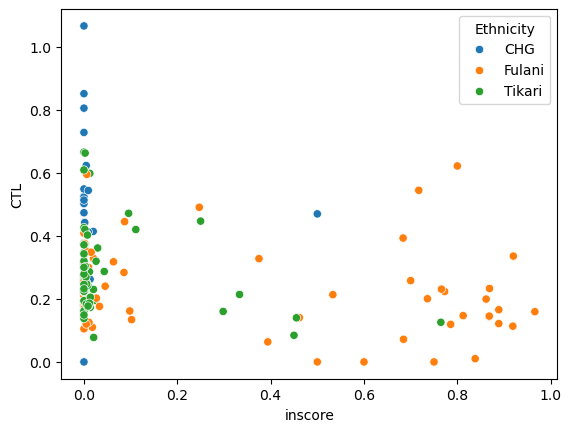

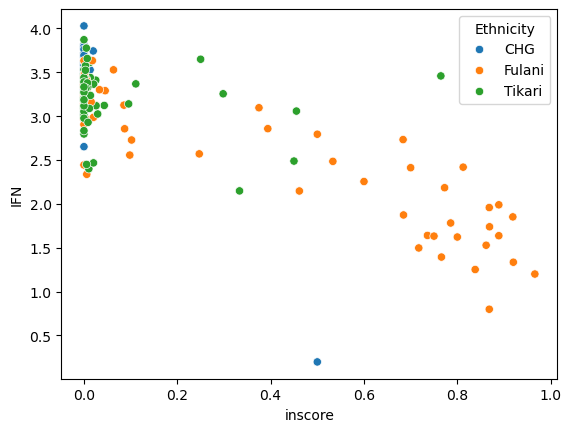

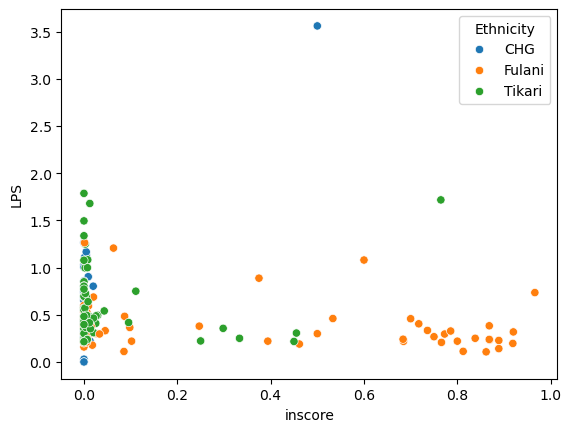

In [41]:
sns.scatterplot(x = ifit3_m['inscore'], y=ifit3_m['CTL'], hue=ifit3_m['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_m['inscore'], y=ifit3_m['IFN'], hue=ifit3_m['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_m['inscore'], y=ifit3_m['LPS'], hue=ifit3_m['Ethnicity'])
plt.show()

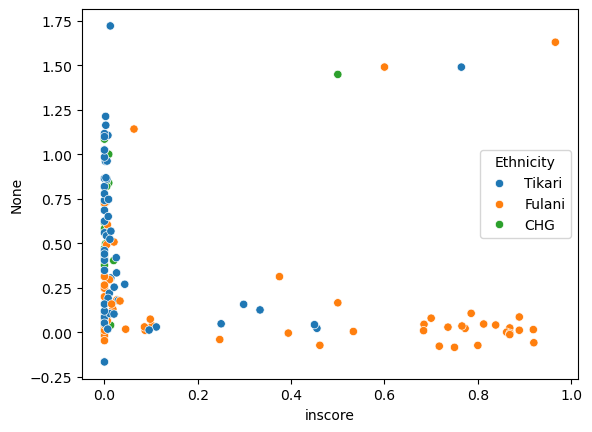

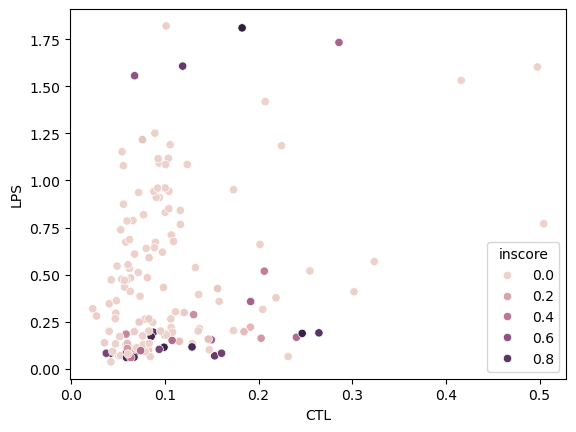

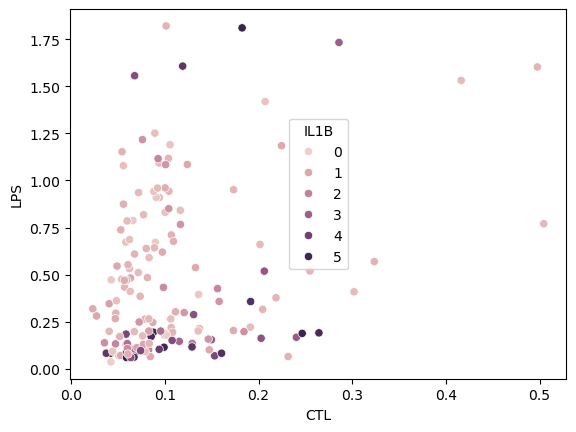

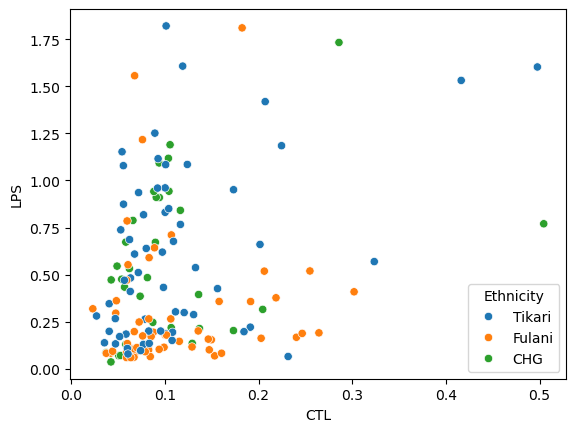

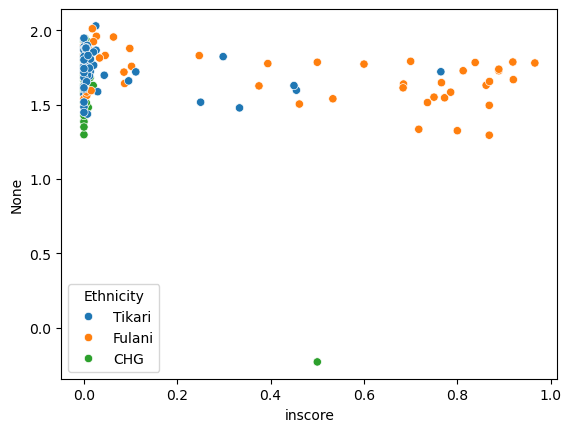

In [320]:
sns.scatterplot(x = ifit3_cd4t['inscore'], y=ifit3_cd4t['LPS'] - ifit3_cd4t['CTL'], hue=ifit3_cd4t['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_cd4t['CTL'], y=ifit3_cd4t['LPS'], hue=ifit3_cd4t['inscore'])
plt.show()
sns.scatterplot(x = ifit3_cd4t['CTL'], y=ifit3_cd4t['LPS'], hue=ifit3_cd4t['IL1B'])
plt.show()
sns.scatterplot(x = ifit3_cd4t['CTL'], y=ifit3_cd4t['LPS'], hue=ifit3_cd4t['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_cd4t['inscore'], y=ifit3_cd4t['IFN'] - ifit3_cd4t['CTL'], hue=ifit3_cd4t['Ethnicity'])
plt.show()

In [343]:
ifit3_cd4t = ifit3_cd4t.merge(il1b_lm)

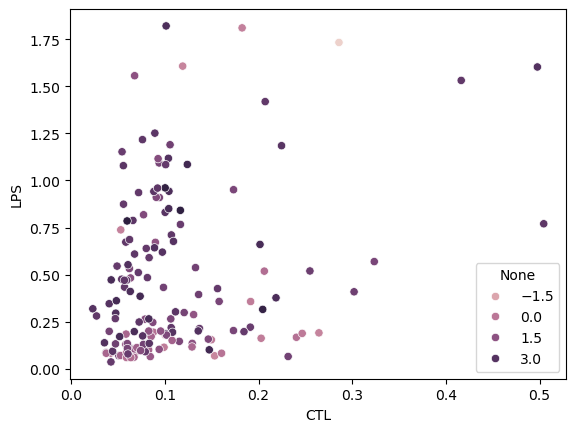

In [347]:
sns.scatterplot(x = ifit3_cd4t['CTL'], y=ifit3_cd4t['LPS'], hue=ifit3_cd4t['IL1B_LPS'] - ifit3_cd4t['IL1B'])
plt.show()

<Axes: xlabel='inscore', ylabel='LPS'>

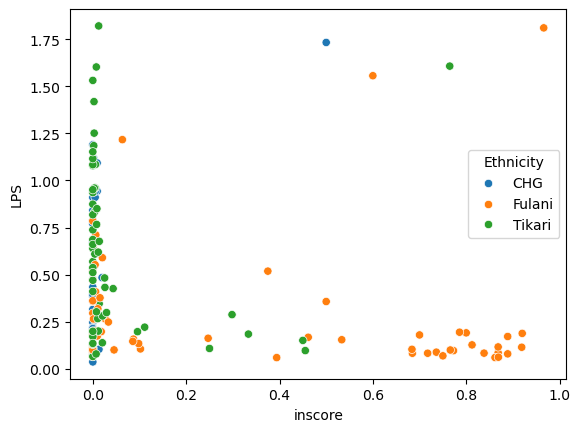

In [348]:
sns.scatterplot(x = ifit3_cd4t['inscore'], y=ifit3_cd4t['LPS'], hue=ifit3_cd4t['Ethnicity'])

In [ ]:
sns.scatterplot(x = ifit3_nk['inscore'], y=ifit3_nk['LPS'] - ifit3_nk['CTL'], hue=ifit3_nk['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_nk['inscore'], y=ifit3_nk['IFN'] - ifit3_nk['CTL'], hue=ifit3_nk['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_nk['inscore'], y=ifit3_nk['LPS'] - ifit3_nk['CTL'], hue=ifit3_nk['site'])
plt.show()

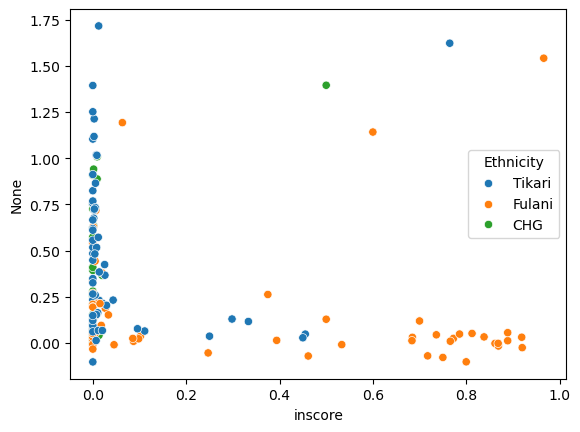

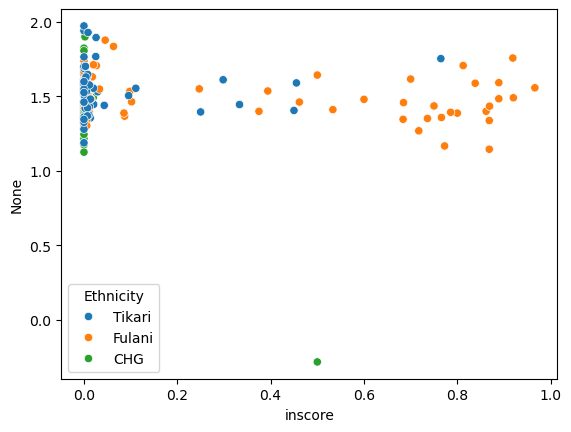

In [304]:
sns.scatterplot(x = ifit3_cd8t['inscore'], y=ifit3_cd8t['LPS'] - ifit3_cd8t['CTL'], hue=ifit3_cd8t['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_cd8t['inscore'], y=ifit3_cd8t['IFN'] - ifit3_cd8t['CTL'], hue=ifit3_cd8t['Ethnicity'])
plt.show()

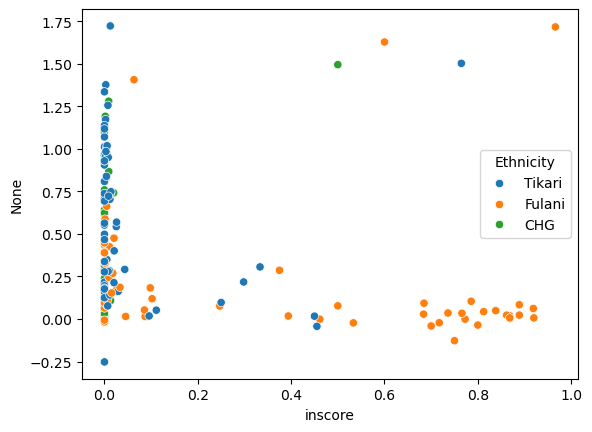

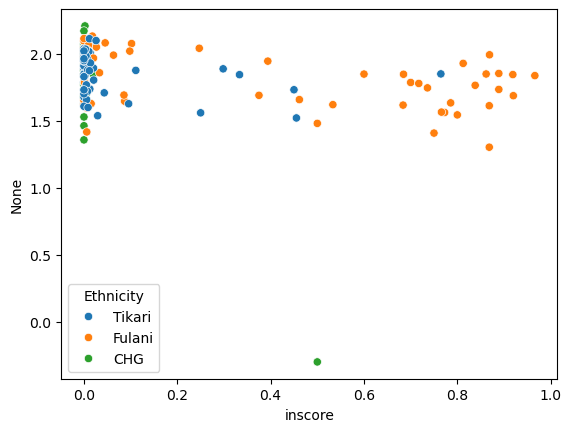

In [305]:
sns.scatterplot(x = ifit3_b['inscore'], y=ifit3_b['LPS'] - ifit3_b['CTL'], hue=ifit3_b['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_b['inscore'], y=ifit3_b['IFN'] - ifit3_b['CTL'], hue=ifit3_b['Ethnicity'])
plt.show()

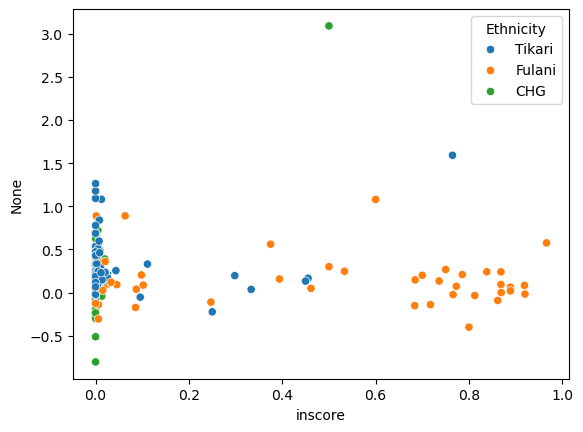

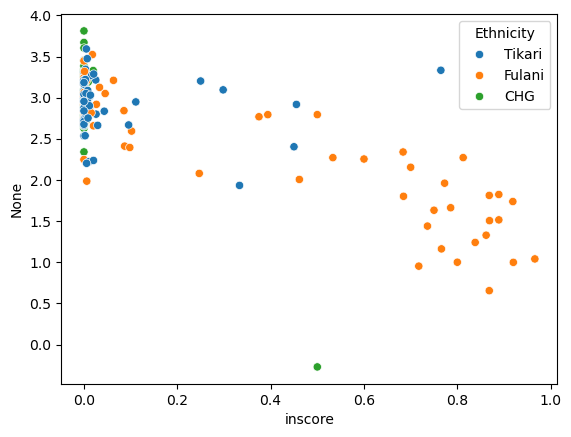

In [307]:
sns.scatterplot(x = ifit3_m['inscore'], y=ifit3_m['LPS'] - ifit3_m['CTL'], hue=ifit3_m['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_m['inscore'], y=ifit3_m['IFN'] - ifit3_m['CTL'], hue=ifit3_m['Ethnicity'])
plt.show()

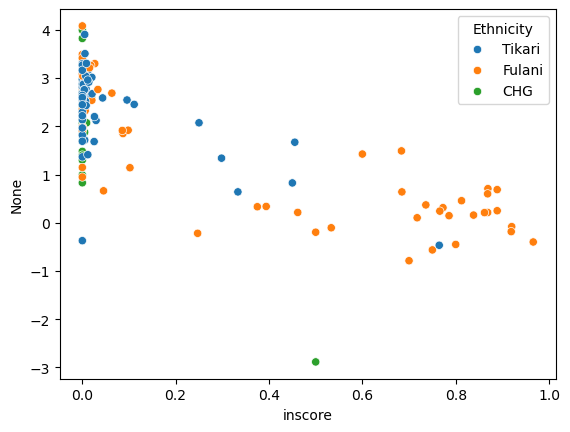

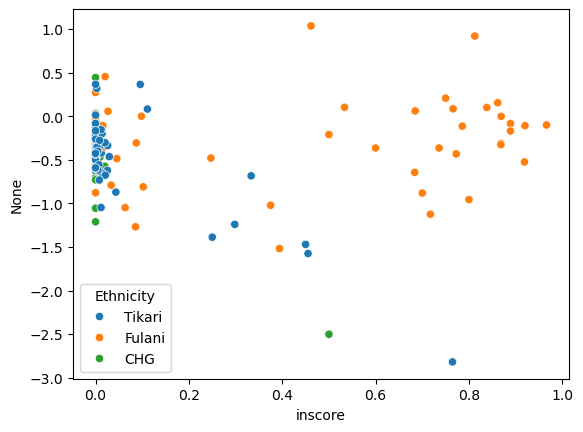

In [312]:
sns.scatterplot(x = il1b_m['inscore'], y=il1b_m['LPS'] - il1b_m['CTL'], hue=il1b_m['Ethnicity'])
plt.show()
sns.scatterplot(x = il1b_m['inscore'], y=il1b_m['IFN'] - il1b_m['CTL'], hue=il1b_m['Ethnicity'])
plt.show()

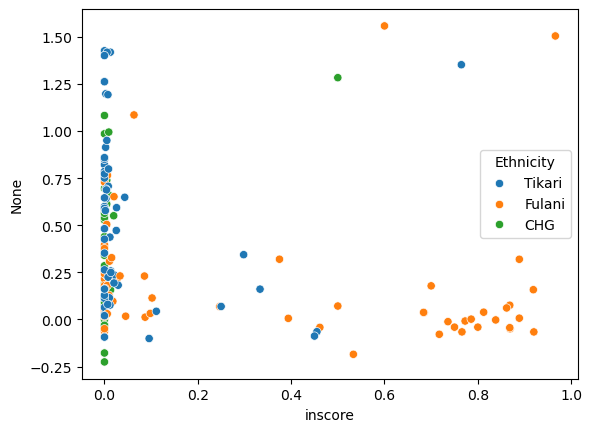

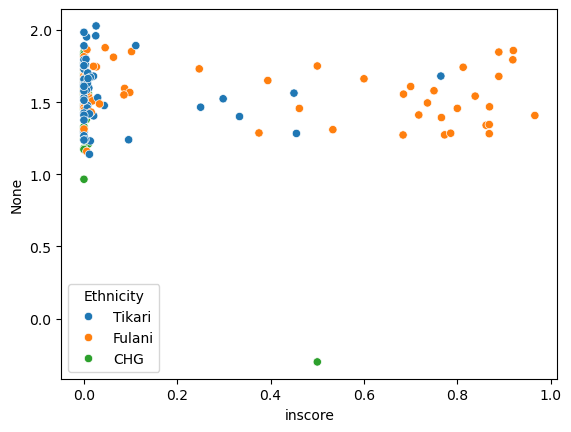

In [324]:
sns.scatterplot(x = ifit3_gdt['inscore'], y=ifit3_gdt['LPS'] - ifit3_gdt['CTL'], hue=ifit3_gdt['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_gdt['inscore'], y=ifit3_gdt['IFN'] - ifit3_gdt['CTL'], hue=ifit3_gdt['Ethnicity'])
plt.show()

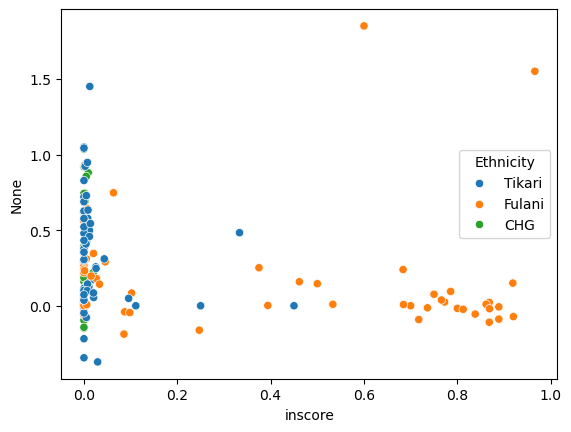

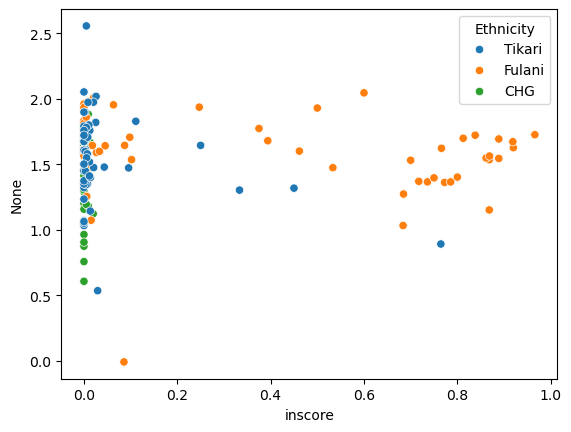

In [329]:
sns.scatterplot(x = ifit3_mait['inscore'], y=ifit3_mait['LPS'] - ifit3_mait['CTL'], hue=ifit3_mait['Ethnicity'])
plt.show()
sns.scatterplot(x = ifit3_mait['inscore'], y=ifit3_mait['IFN'] - ifit3_mait['CTL'], hue=ifit3_mait['Ethnicity'])
plt.show()

<Axes: xlabel='inscore', ylabel='None'>

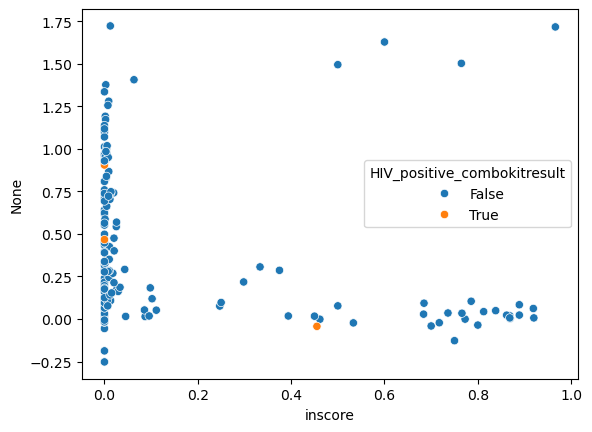

In [187]:
sns.scatterplot(x = ifit3['inscore'], y=ifit3['LPS'] - ifit3['CTL'], hue=ifit3['HIV_positive_combokitresult'])

<Axes: xlabel='inscore', ylabel='None'>

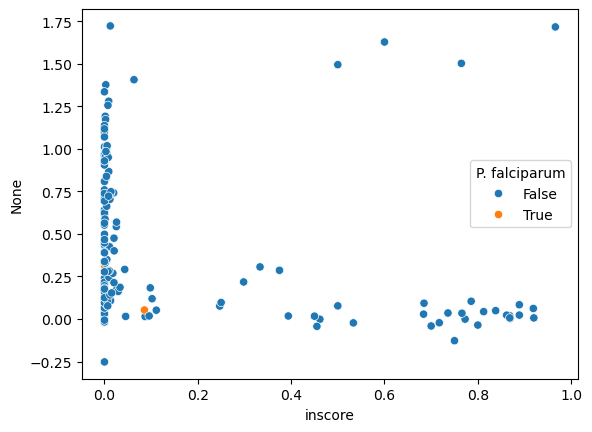

In [262]:
sns.scatterplot(x = ifit3['inscore'], y=ifit3['LPS'] - ifit3['CTL'], hue=ifit3['P. falciparum'])

<Axes: xlabel='inscore', ylabel='None'>

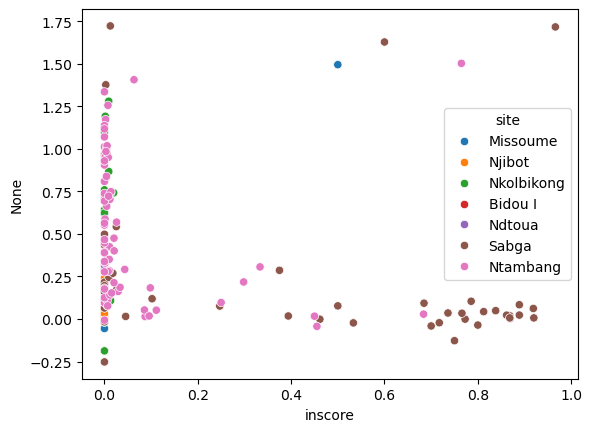

In [197]:
sns.scatterplot(x = ifit3['inscore'], y=ifit3['LPS'] - ifit3['CTL'], hue=ifit3['site'])

<Axes: xlabel='inscore', ylabel='None'>

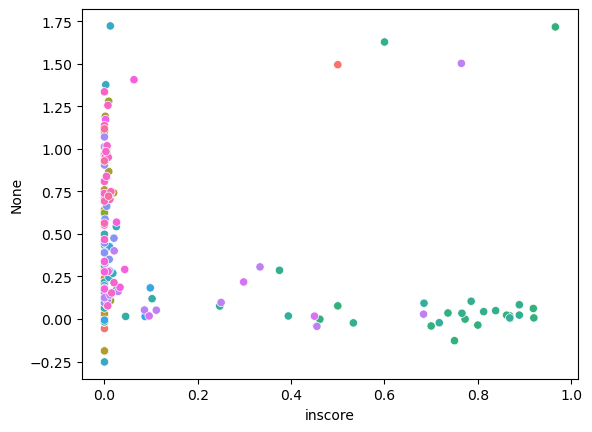

In [209]:
sns.scatterplot(x = ifit3['inscore'], y=ifit3['LPS'] - ifit3['CTL'], hue=ifit3['date'], legend=None)

In [268]:
ifit3 = ifit3.merge(adata_b.obs[['FID','AGE']].drop_duplicates())

In [266]:
ifit3 = ifit3.merge(rna_path[['FID','P.f.nm0']])

<Axes: xlabel='inscore', ylabel='None'>

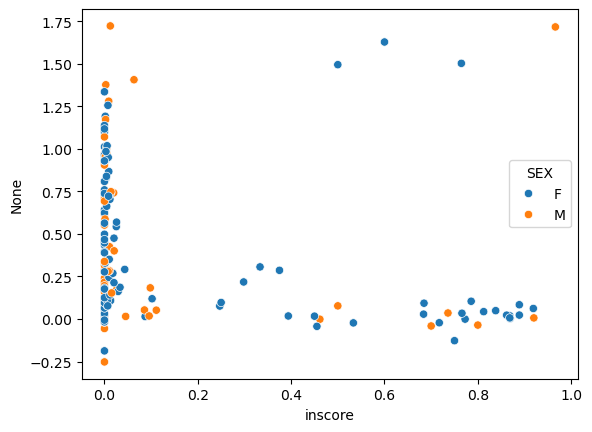

In [201]:
sns.scatterplot(x = ifit3['inscore'], y=ifit3['LPS'] - ifit3['CTL'], hue=ifit3['SEX'])

<Axes: xlabel='inscore', ylabel='None'>

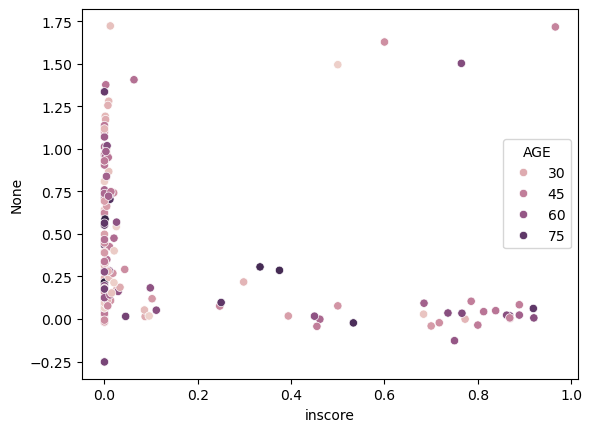

In [269]:
sns.scatterplot(x = ifit3['inscore'], y=ifit3['LPS'] - ifit3['CTL'], hue=ifit3['AGE'])

<Axes: xlabel='inscore', ylabel='None'>

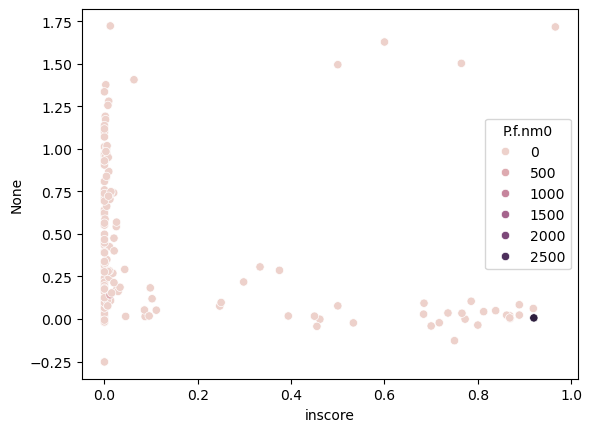

In [265]:
sns.scatterplot(x = ifit3['inscore'], y=ifit3['LPS'] - ifit3['CTL'], hue=ifit3['P.f.nm0'])

<Axes: xlabel='inscore', ylabel='None'>

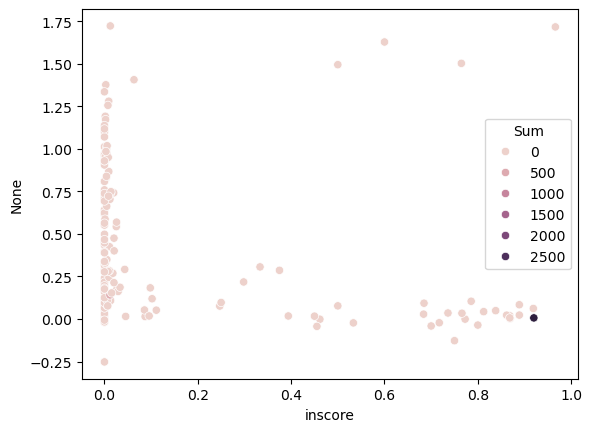

In [259]:
sns.scatterplot(x = ifit3['inscore'], y=ifit3['LPS'] - ifit3['CTL'], hue=ifit3['Sum'])

<Axes: xlabel='inscore', ylabel='None'>

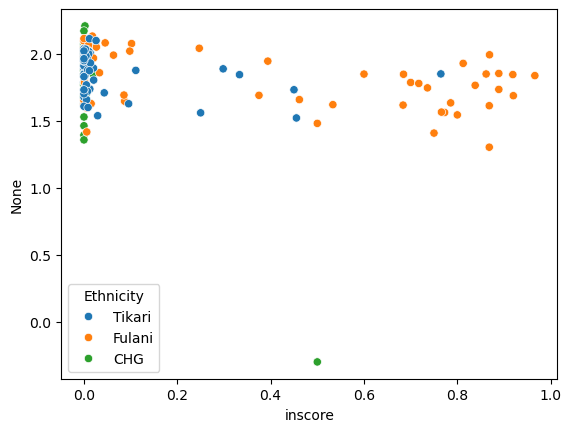

In [188]:
sns.scatterplot(x = ifit3['inscore'], y=ifit3['IFN'] - ifit3['CTL'], hue=ifit3['Ethnicity'])

In [183]:
ifit3.columns

Index(['FID', 'CTL', 'IFN', 'LPS', 'inscore', 'Ethnicity', 'IL1B',
       'HIV_positive_combokitresult', 'Date_Combo_Kit_Done', 'NEUTROPHILE',
       'LYMPHOCYTE', 'MONOCYTE', 'EOSINOPHILE', 'BASOPHILE',
       'Mf M. perstans (synonym D. perstans)', 'P. falciparum', 'Mf Loa loa',
       'W. bancrofti', 'Microfilaria spp', 'Ascaris lumbricoides eggs',
       'Trichomonas intestinalis eggs', 'Trichuris trichiura eggs', 'E. coli ',
       'E. histolytica cysts',
       'Hookworm (Ancylostoma duodenale or Necator americanus eggs)',
       'Giardia lamblia', 'Strongyloides stercoralis'],
      dtype='object')

In [130]:
klhl14 = b_means[['FID','COND','KLHL14']].pivot(index='FID', columns='COND', values='KLHL14').reset_index().merge(f24_frac)
klhl14 = klhl14.merge(adata_b.obs[['FID','Ethnicity']].drop_duplicates())

In [140]:
klhl14 = klhl14.merge(il1b_cm)

In [146]:
klhl14['Ethnicity'] = pd.Categorical(klhl14['Ethnicity'], categories=['Tikari','Fulani','CHG'])

<Axes: xlabel='inscore', ylabel='None'>

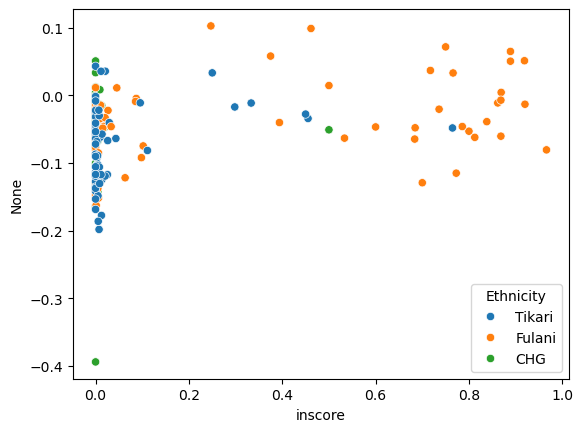

In [147]:
sns.scatterplot(x = klhl14['inscore'], y=klhl14['LPS'] - klhl14['CTL'], hue=klhl14['Ethnicity'])

<Axes: xlabel='IL1B', ylabel='None'>

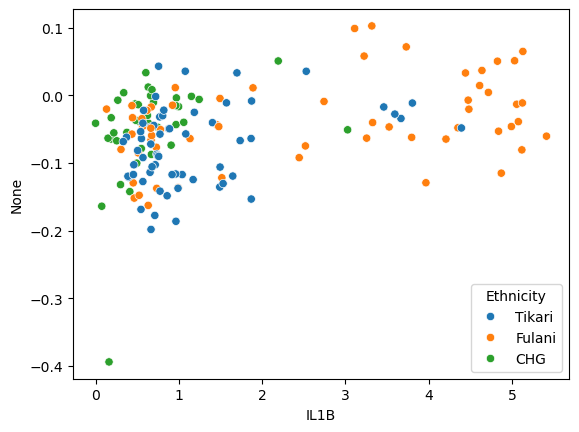

In [148]:
sns.scatterplot(x = klhl14['IL1B'], y=klhl14['LPS'] - klhl14['CTL'], hue=klhl14['Ethnicity'])

In [160]:
klhl14 = klhl14.merge(pathogens)

In [161]:
klhl14

,FID,CTL,IFN,LPS,inscore,Ethnicity,IL1B,HIV_positive_combokitresult,Date_Combo_Kit_Done,NEUTROPHILE,...,W. bancrofti,Microfilaria spp,Ascaris lumbricoides eggs,Trichomonas intestinalis eggs,Trichuris trichiura eggs,E. coli,E. histolytica cysts,Hookworm (Ancylostoma duodenale or Necator americanus eggs),Giardia lamblia,Strongyloides stercoralis
0,D0005,0.320524,0.066801,0.307810,0.000000,CHG,0.474219,False,2017-03-14 00:00:00,32,...,False,False,True,False,False,True,False,False,False,False
1,D0010,0.167626,0.067091,0.218480,0.000000,CHG,2.193361,False,2017-03-14 00:00:00,37,...,False,False,True,False,False,False,False,False,False,False
2,D0017,0.178760,0.192073,0.127823,0.500000,CHG,3.026381,False,2017-03-14 00:00:00,18,...,False,False,False,False,False,False,False,False,False,False
3,D0019,0.232705,0.089255,0.231212,0.000000,CHG,1.150868,False,2017-03-14 00:00:00,13,...,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,D0028,0.099532,0.059645,0.095790,0.000000,CHG,0.970285,False,2017-03-14 00:00:00,29,...,False,False,True,False,False,True,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157,D1339,0.314707,0.060366,0.146098,0.000000,Tikari,0.545176,False,2017-06-08 00:00:00,44,...,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
158,D1342,0.290781,0.080693,0.173712,0.000000,Tikari,0.454304,False,2017-06-08 00:00:00,38,...,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
159,D1360,0.234443,0.083529,0.081142,0.000000,Tikari,1.869207,False,2017-06-08 00:00:00,33,...,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
160,D1363,0.275325,0.129477,0.185055,0.000000,Tikari,0.757824,False,2017-06-08 00:00:00,42,...,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [245]:
blc = pd.read_csv("../memento/output/memento.NK.CHG.CTL_IFN.COND.csv")
blf = pd.read_csv("../memento/output/memento.NK.Fulani.CTL_IFN.COND.csv")
blt = pd.read_csv("../memento/output/memento.NK.Tikari.CTL_IFN.COND.csv")

In [246]:
blc.sort_values('de_coef', ascending=True).head()

,Unnamed: 0,gene,tx,de_coef,de_se,de_pval,dv_coef,dv_se,dv_pval
2754,2754,APOLD1,IFN,-1.094944,0.044472,8.101933e-127,-0.197695,0.084902,0.103485
3338,3338,DAPK2,IFN,-1.054793,0.030511,1.858563e-252,0.088770,0.053966,0.052357
3051,3051,CKAP2,IFN,-0.989964,0.034554,1.639543e-176,0.016217,0.106869,0.752230
1849,1849,HIP1,IFN,-0.986773,0.033940,1.782780e-180,0.243773,0.055402,0.000006
2661,2661,SESN3,IFN,-0.939798,0.035044,5.262897e-153,-0.234084,0.104178,0.134067


In [247]:
blf.sort_values('de_coef', ascending=True).head(10)

,Unnamed: 0,gene,tx,de_coef,de_se,de_pval,dv_coef,dv_se,dv_pval
347,347,S100A4,IFN,-1.172764,0.018730,0.000000e+00,-0.057033,0.050125,6.849042e-01
2348,2348,ATXN7L1,IFN,-1.171617,0.022051,0.000000e+00,0.221321,0.057462,5.897412e-05
1811,1811,SGCD,IFN,-1.159841,0.037749,4.389721e-202,-0.121437,0.048204,1.518811e-01
4316,4316,ADGRG5,IFN,-1.136310,0.023128,0.000000e+00,0.395081,0.056360,1.193235e-12
1356,1356,MXD4,IFN,-1.076422,0.019230,0.000000e+00,0.106506,0.101132,3.217314e-01
5283,5283,PIK3IP1,IFN,-1.058318,0.022073,0.000000e+00,0.287517,0.110226,6.643677e-03
3647,3647,KDM2B,IFN,-1.001989,0.023742,0.000000e+00,0.033788,0.082883,4.255123e-01
2274,2274,HIP1,IFN,-0.994220,0.023550,0.000000e+00,0.430897,0.038832,6.533679e-29
4186,4186,IGF1R,IFN,-0.946501,0.023554,0.000000e+00,0.138336,0.051284,3.568642e-03
3866,3866,PTGDR,IFN,-0.938184,0.025778,3.932580e-284,0.207431,0.083919,7.601973e-03


In [248]:
blc.sort_values('de_coef', ascending=True).head(15)

,Unnamed: 0,gene,tx,de_coef,de_se,de_pval,dv_coef,dv_se,dv_pval
2754,2754,APOLD1,IFN,-1.094944,0.044472,8.101933e-127,-0.197695,0.084902,0.103485
3338,3338,DAPK2,IFN,-1.054793,0.030511,1.858563e-252,0.088770,0.053966,0.052357
3051,3051,CKAP2,IFN,-0.989964,0.034554,1.639543e-176,0.016217,0.106869,0.752230
1849,1849,HIP1,IFN,-0.986773,0.033940,1.782780e-180,0.243773,0.055402,0.000006
2661,2661,SESN3,IFN,-0.939798,0.035044,5.262897e-153,-0.234084,0.104178,0.134067
4210,4210,PIK3IP1,IFN,-0.934486,0.029416,3.185826e-217,0.319469,0.140754,0.013167
281,281,S100A4,IFN,-0.881448,0.027756,3.591800e-217,-0.232997,0.078315,0.006213
2119,2119,TMEM71,IFN,-0.873960,0.034577,6.208485e-138,-0.054425,0.104150,0.893554
2253,2253,STRBP,IFN,-0.868603,0.044591,5.117116e-81,-0.139206,0.088166,0.355380
2149,2149,BNC2,IFN,-0.852462,0.055454,2.296517e-50,-0.221668,0.104493,0.050070


In [30]:
f24_cm_means = grouped_obs_mean(adata_cm, 'FID', layer=None, gene_symbols=None)

<Axes: ylabel='Frequency'>

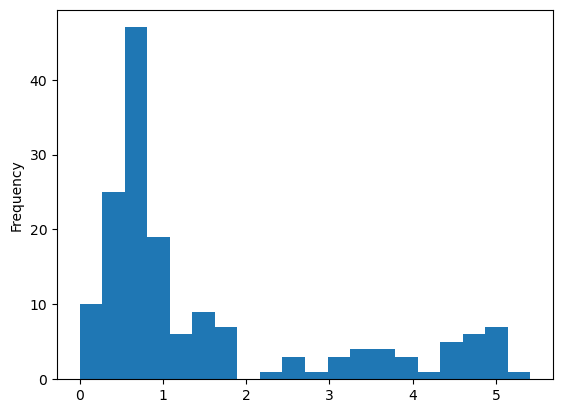

In [31]:
f24_cm_means.transpose()['IL1B'].plot.hist(bins=20)

In [101]:
adata.layers['counts'] = adata.X.copy()

In [ ]:
# Normalizing to median total counts
sc.pp.normalize_total(adata)
# Logarithmize the data
sc.pp.log1p(adata)

In [ ]:
adata_means = grouped_obs_mean(adata, ['FID','cytopus_names','COND'], layer=None, gene_symbols=None)

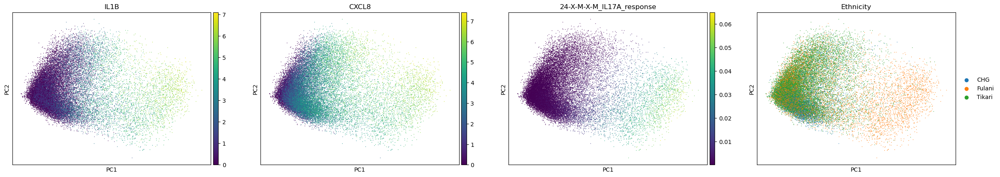

In [32]:
sc.pl.pca(adata_cm, color=['IL1B','CXCL8','24-X-M-X-M_IL17A_response','Ethnicity','])

In [33]:
adata_cm.obs['f24_PC1'] = adata_cm.obsm['X_pca'][:,0]

In [28]:
sc.pp.neighbors(adata_cm)

Exception ignored on calling ctypes callback function: <function ExecutionEngine._raw_object_cache_notify at 0x2b6936766020>
Traceback (most recent call last):
  File "/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/llvmlite/binding/executionengine.py", line 171, in _raw_object_cache_notify
    def _raw_object_cache_notify(self, data):

KeyboardInterrupt: 

KeyboardInterrupt



In [36]:
sc.tl.umap(adata_cm)

In [27]:
sc.tl.leiden(adata_cm, flavor="igraph", n_iterations=2)

KeyError: 'No "neighbors" in .uns'

In [ ]:
sc.pl.umap(adata_cm, color='24-X-M-X-M_IL17A_response')

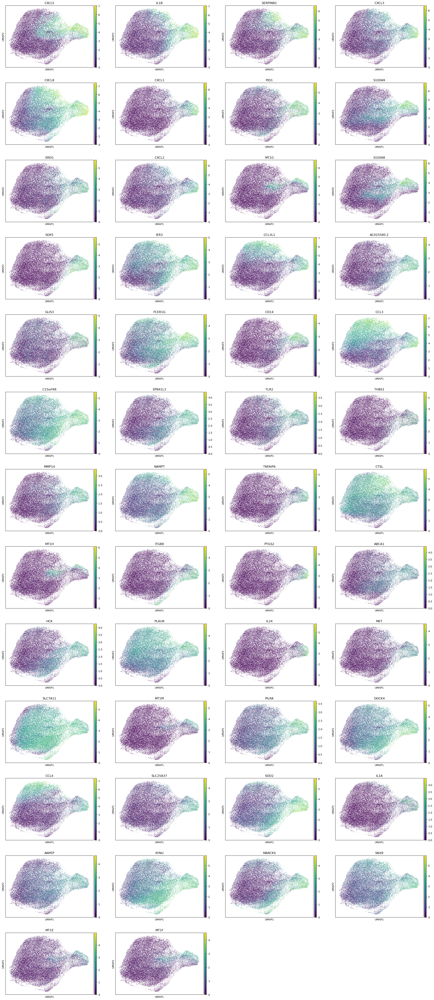

In [82]:
sc.pl.umap(adata_cm, color=adata.uns['SPECTRA_markers'][24])

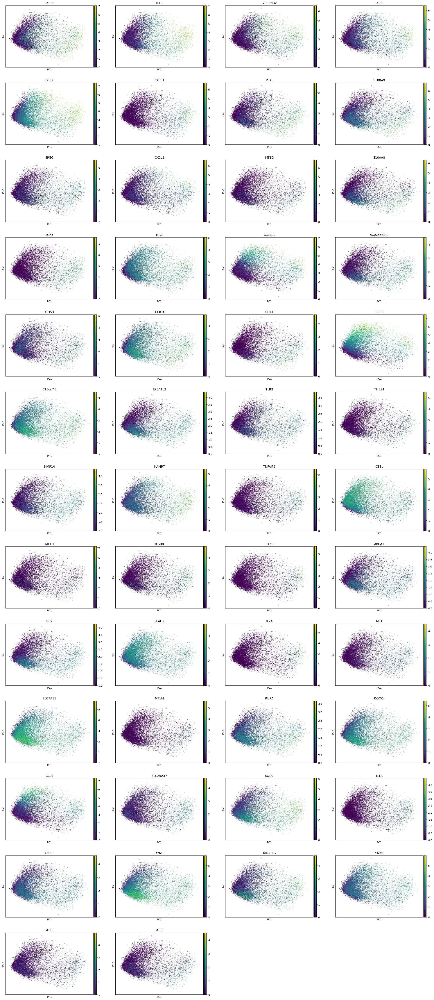

In [92]:
sc.pl.pca(adata_cm, color=adata.uns['SPECTRA_markers'][24])

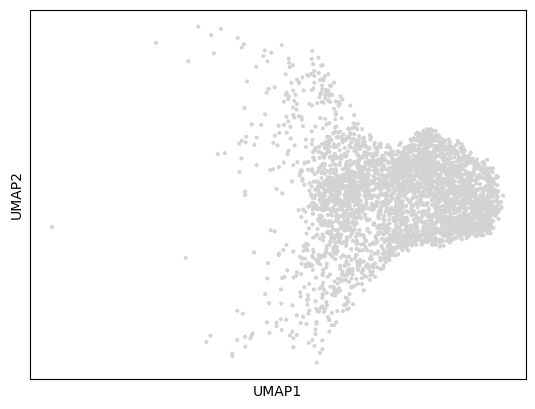

In [37]:
sc.pl.umap(adata_cm[adata_cm.obs['24-X-M-X-M_IL17A_response'] > 0.01])

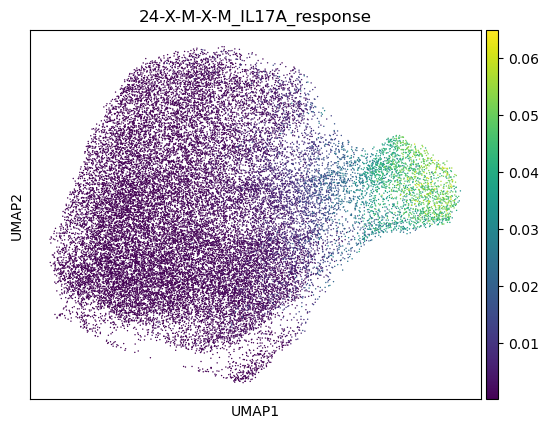

In [39]:
sc.pl.umap(adata_cm, color='24-X-M-X-M_IL17A_response')

In [40]:
sc.tl.leiden(adata_cm, flavor="igraph", n_iterations=2)

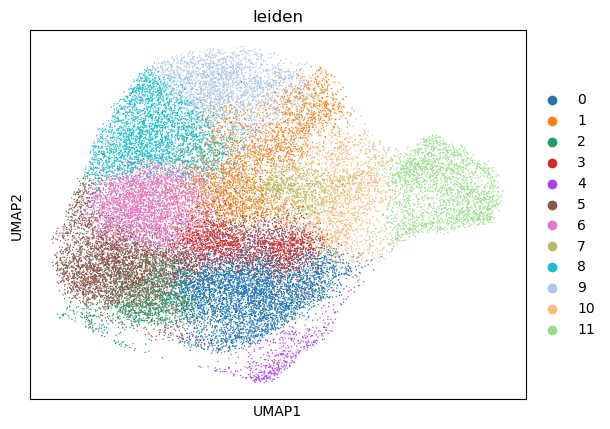

In [41]:
sc.pl.umap(adata_cm, color='leiden')

In [55]:
# get fraction of cells in factor 24 cluster
f24_frac = pd.DataFrame({'FID': adata_cm.obs['FID'], 'is_11': adata_cm.obs['leiden']=="11"}) \
    .groupby('FID')['is_11'].mean().reset_index()

In [56]:
f24_frac

,FID,is_11
0,D0005,0.000000
1,D0010,0.000000
2,D0017,0.500000
3,D0019,0.000000
4,D0028,0.000000
...,...,...
157,D1339,0.000000
158,D1342,0.000000
159,D1360,0.000000
160,D1363,0.000000


In [57]:
cm_means = grouped_obs_mean(adata_cm, 'FID')

<Axes: xlabel='is_11', ylabel='IL1B'>

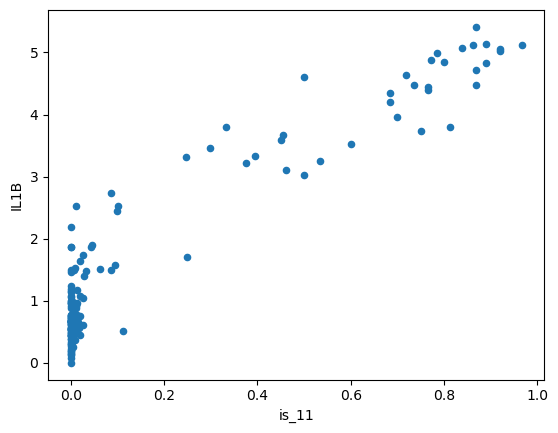

In [62]:
cm_means.transpose()['IL1B'].reset_index().rename(columns={'index': 'FID'}) \
    .merge(f24_frac).plot.scatter(x='is_11', y='IL1B')

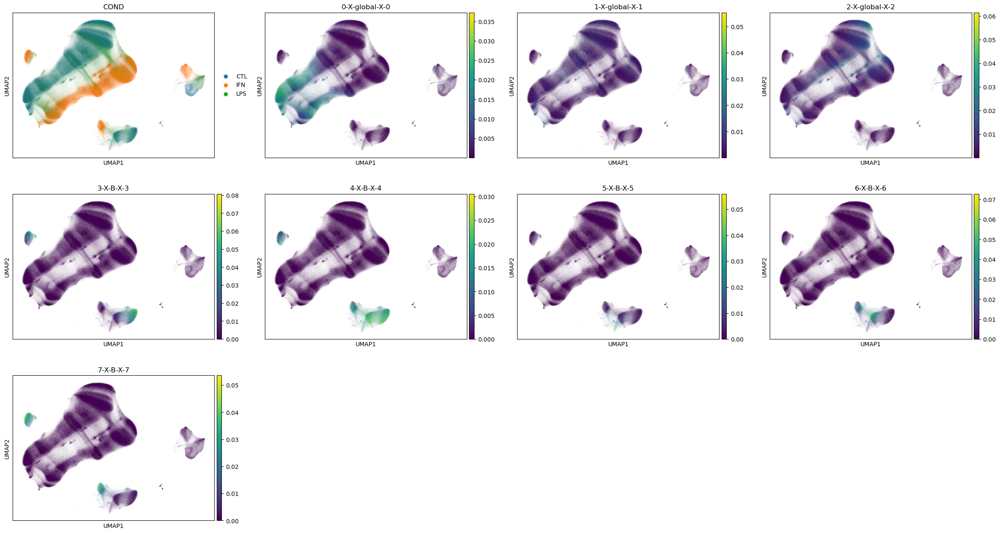

In [34]:
sc.pl.umap(adata, color=['COND','0-X-global-X-0', '1-X-global-X-1', 
                         '2-X-global-X-2', '3-X-B-X-3', 
                         '4-X-B-X-4', '5-X-B-X-5', 
                         '6-X-B-X-6', '7-X-B-X-7'])

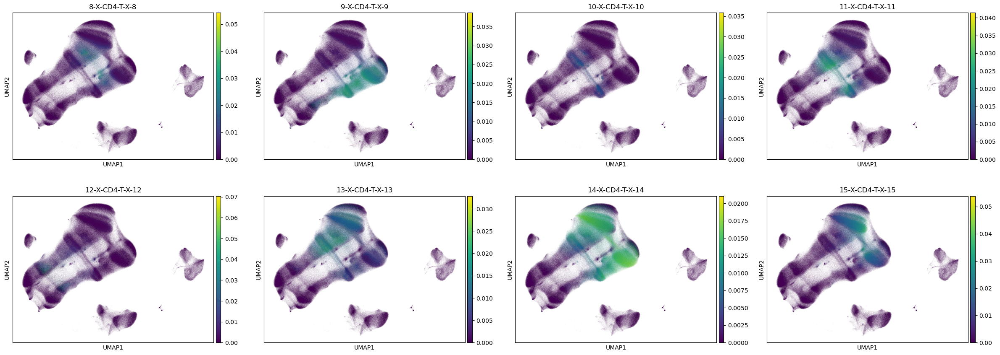

In [35]:
sc.pl.umap(adata, color=['8-X-CD4-T-X-8', '9-X-CD4-T-X-9', 
                         '10-X-CD4-T-X-10', '11-X-CD4-T-X-11',
                         '12-X-CD4-T-X-12', '13-X-CD4-T-X-13', 
                         '14-X-CD4-T-X-14', '15-X-CD4-T-X-15'])

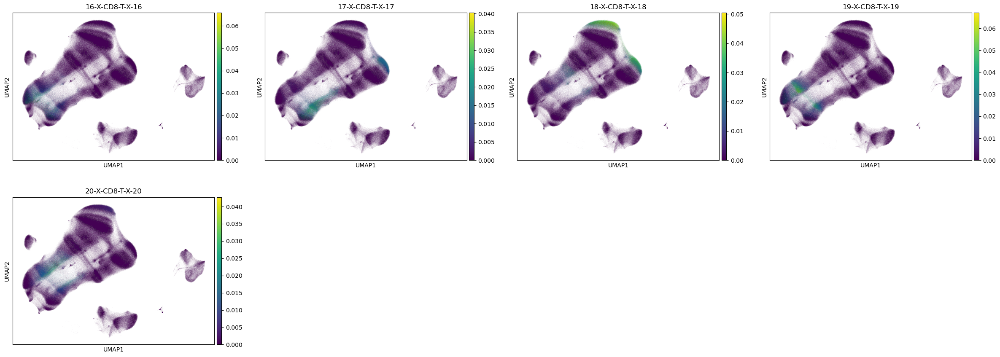

In [38]:
sc.pl.umap(adata, color=['16-X-CD8-T-X-16', '17-X-CD8-T-X-17',
                         '18-X-CD8-T-X-18', '19-X-CD8-T-X-19', 
                         '20-X-CD8-T-X-20'])

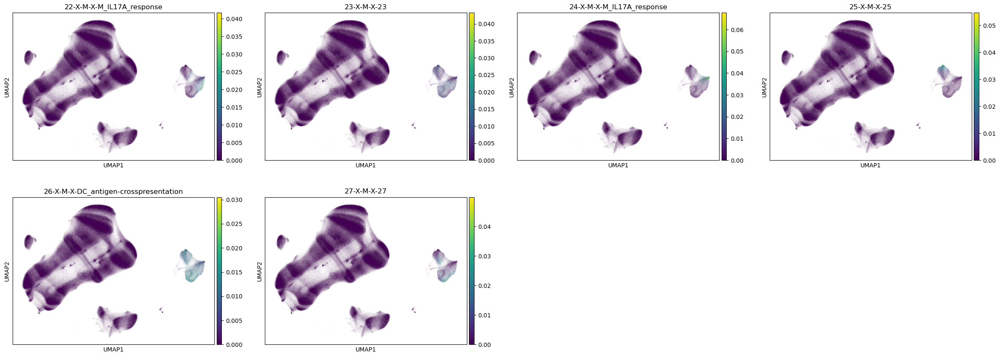

In [39]:
sc.pl.umap(adata, color=['22-X-M-X-M_IL17A_response', '23-X-M-X-23',
                         '24-X-M-X-M_IL17A_response', '25-X-M-X-25',
                         '26-X-M-X-DC_antigen-crosspresentation', '27-X-M-X-27'])

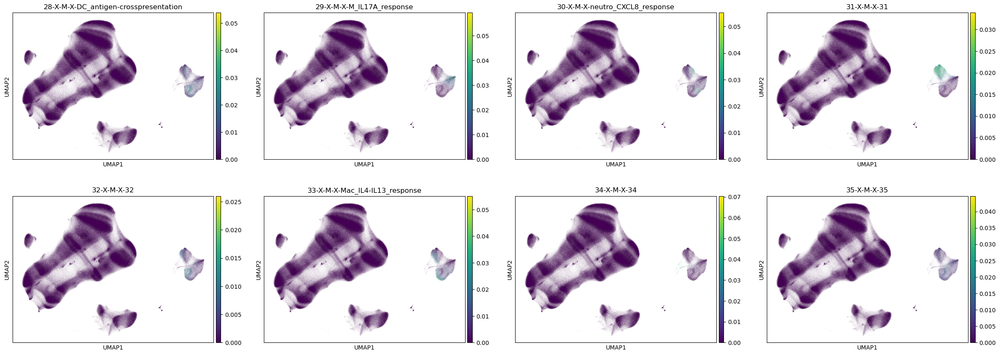

In [41]:
sc.pl.umap(adata, color=['28-X-M-X-DC_antigen-crosspresentation', '29-X-M-X-M_IL17A_response',
                         '30-X-M-X-neutro_CXCL8_response', '31-X-M-X-31', '32-X-M-X-32',
                         '33-X-M-X-Mac_IL4-IL13_response', '34-X-M-X-34', '35-X-M-X-35'])

In [ ]:
sc.pl.umap(adata, color=['21-X-DNT-X-21', '36-X-MAIT-X-36', 
                         '37-X-NK-X-37', '38-X-NK-X-38',
                         '39-X-Progenitor-X-39', '40-X-gdT-X-40'])

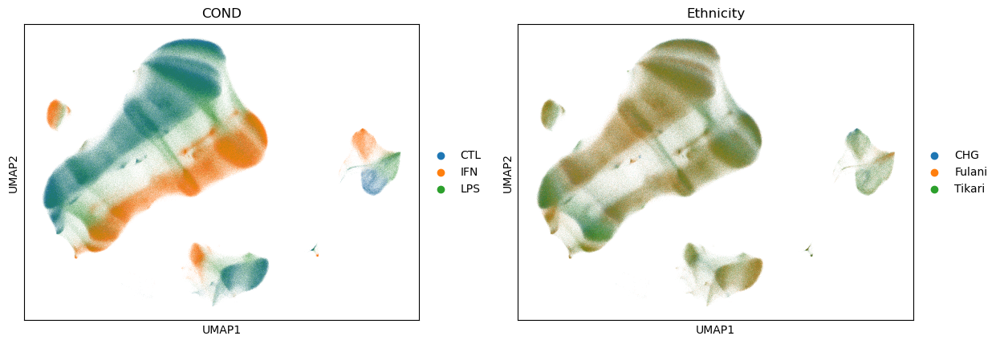

In [42]:
sc.pl.umap(adata, color=['COND','Ethnicity'])

In [37]:
adata.uns['SPECTRA_overlap'].index

Index(['0-X-global-X-0', '1-X-global-X-1', '2-X-global-X-2', '3-X-B-X-3',
       '4-X-B-X-4', '5-X-B-X-5', '6-X-B-X-6', '7-X-B-X-7', '8-X-CD4-T-X-8',
       '9-X-CD4-T-X-9', '10-X-CD4-T-X-10', '11-X-CD4-T-X-11',
       '12-X-CD4-T-X-12', '13-X-CD4-T-X-13', '14-X-CD4-T-X-14',
       '15-X-CD4-T-X-15', '16-X-CD8-T-X-16', '17-X-CD8-T-X-17',
       '18-X-CD8-T-X-18', '19-X-CD8-T-X-19', '20-X-CD8-T-X-20',
       '21-X-DNT-X-21', '22-X-M-X-M_IL17A_response', '23-X-M-X-23',
       '24-X-M-X-M_IL17A_response', '25-X-M-X-25',
       '26-X-M-X-DC_antigen-crosspresentation', '27-X-M-X-27',
       '28-X-M-X-DC_antigen-crosspresentation', '29-X-M-X-M_IL17A_response',
       '30-X-M-X-neutro_CXCL8_response', '31-X-M-X-31', '32-X-M-X-32',
       '33-X-M-X-Mac_IL4-IL13_response', '34-X-M-X-34', '35-X-M-X-35',
       '36-X-MAIT-X-36', '37-X-NK-X-37', '38-X-NK-X-38',
       '39-X-Progenitor-X-39', '40-X-gdT-X-40'],
      dtype='object')

In [76]:
adata.obs['f24_frac'] = list(adata.obs[['FID']].merge(f24_frac)['is_11'])

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


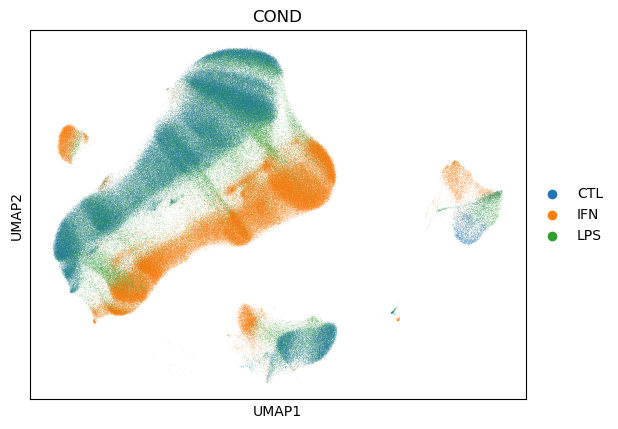

In [78]:
sc.pl.umap(adata[adata.obs['f24_frac'] > 0.3], color='COND')

In [ ]:
sc.pl.umap(adata[adata.obs['f24_frac'] < 0.3], color='COND')

/home/derkelly/miniconda3/envs/ctypist/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


In [72]:
adata.uns['SPECTRA_overlap'].index

Index(['0-X-global-X-0', '1-X-global-X-1', '2-X-global-X-2', '3-X-B-X-3',
       '4-X-B-X-4', '5-X-B-X-5', '6-X-B-X-6', '7-X-B-X-7', '8-X-CD4-T-X-8',
       '9-X-CD4-T-X-9', '10-X-CD4-T-X-10', '11-X-CD4-T-X-11',
       '12-X-CD4-T-X-12', '13-X-CD4-T-X-13', '14-X-CD4-T-X-14',
       '15-X-CD4-T-X-15', '16-X-CD8-T-X-16', '17-X-CD8-T-X-17',
       '18-X-CD8-T-X-18', '19-X-CD8-T-X-19', '20-X-CD8-T-X-20',
       '21-X-DNT-X-21', '22-X-M-X-M_IL17A_response', '23-X-M-X-23',
       '24-X-M-X-M_IL17A_response', '25-X-M-X-25',
       '26-X-M-X-DC_antigen-crosspresentation', '27-X-M-X-27',
       '28-X-M-X-DC_antigen-crosspresentation', '29-X-M-X-M_IL17A_response',
       '30-X-M-X-neutro_CXCL8_response', '31-X-M-X-31', '32-X-M-X-32',
       '33-X-M-X-Mac_IL4-IL13_response', '34-X-M-X-34', '35-X-M-X-35',
       '36-X-MAIT-X-36', '37-X-NK-X-37', '38-X-NK-X-38',
       '39-X-Progenitor-X-39', '40-X-gdT-X-40'],
      dtype='object')

In [ ]:
#dates = ['2015-06-14 00:00:00','2015-06-15 00:00:00','2015-06-16 00:00:00','2015-06-17 00:00:00']
dates = ['2015-06-14 00:00:00','2015-06-15 00:00:00','2015-06-16 00:00:00']

In [ ]:
site_date = adata.obs[['FID']].merge(site_collect[['FID','site','date']])
adata.obs['site'] = list(site_date['site'])
adata.obs['date'] = list(site_date['date'])

In [ ]:
adata_nsj = adata[~adata.obs['sj']]

In [ ]:
adata.obs['sj'] = list(adata.obs['date'].isin(dates))

In [ ]:
gc.collect()

In [ ]:
sns.scatterplot(x=adata_sj.obsm['X_umap'][:,0], y=adata_sj.obsm['X_umap'][:,1], hue=adata_sj.obs['COND'],size=0.01)

In [ ]:
sns.scatterplot(x=adata_nsj.obsm['X_umap'][:,0], y=adata_nsj.obsm['X_umap'][:,1], hue=adata_nsj.obs['COND'],size=0.01)

In [64]:
pathogens.head()

,NWD_ID,field_ID,loaloa.reads,loaloa.contigs,Country,Gender,Age,PopName,Site,LabID,P.f.nm0,P.m.nm0,P.v.nm0...rAM,PvWTSI.nm0...rAM,P.o.nm0...rAM,PocGH01.nm0.rAM,Sum
0,NWD100165,D1138,0,0,Cameroon,F,60,TIKARI,NTAMBANG,CATK105,0,0,0,0,0,0,0
1,NWD101008,D0918,1,1,Cameroon,M,41,TIKARI,SABGA,CATK022,0,0,0,0,0,0,0
2,NWD113212,D0755,0,0,Cameroon,M,35,FULANI MBORORO,SABGA,CAMF076,0,0,0,0,0,0,0
3,NWD113624,D0950,4,4,Cameroon,M,28,FULANI MBORORO,SABGA,CAMF217,0,1,0,0,0,0,1
4,NWD114257,D0158,4,4,Cameroon,F,23,BAKA,NKOLBIKONG,CAPB201,0,0,0,0,0,0,0


In [65]:
path_df = adata.obs[['FID']].merge(pathogens[['field_ID','Sum']].rename(columns={'field_ID': 'FID'}), how='left')

In [66]:
adata.obs['pathogen_sum'] = list(path_df['Sum'])

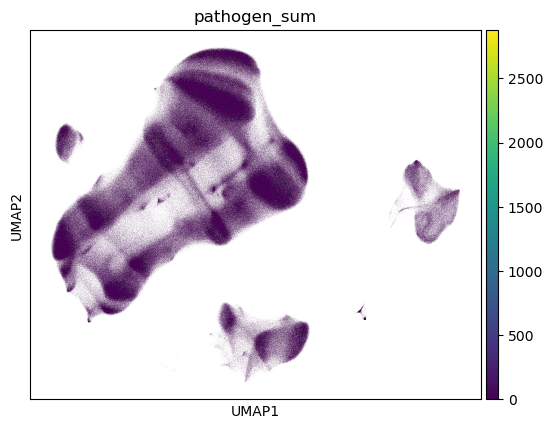

In [67]:
sc.pl.umap(adata[adata.obs['pathogen_sum'] > 500], color='pathogen_sum')

## Other

In [ ]:
adata_c.obs['cytopus_names'].value_counts()

In [ ]:
cnts_c = grouped_obs_sum(adata_c, group_key='FID')

In [ ]:
#mean_c = grouped_obs_mean(adata_c, group_key='FID')
mean_c = grouped_obs_mean(spectra[(spectra.obs['cytopus_names']=="M") & (spectra.obs['COND']=="CTL")],
                          group_key='FID')

In [ ]:
plot_df = mean_c.transpose() \
    .reset_index() \
    .rename(columns={'index': 'FID'}) \
    .merge(spectra.obs[['FID','Ethnicity']].drop_duplicates()) \
    .merge(site_collect[['FID','site','date']]) \
    .sort_values('date')

In [ ]:
ax = sns.boxplot(plot_df, x='date', y='IL1A', hue='Ethnicity')
ax.tick_params(axis='x', rotation=90)

In [ ]:
spectra.obs['f24_sum'] = spectra.obsm['SPECTRA_cell_scores'][:,24] > 0.01

In [ ]:
foo = spectra.obs.groupby(['cytopus_names','FID'])['f24_sum'].mean().reset_index()

In [ ]:
foo = foo.merge(spectra.obs[['FID','Ethnicity']].drop_duplicates()).merge(site_collect[['FID','site','date']])

In [ ]:
infect = pd.read_csv("../../misc/pathogen_data.csv")

In [ ]:
foo = foo.merge(infect[['FID','Pathogen']])

In [ ]:
foo.sort_values('f24_sum', ascending=False).head(50)

In [ ]:
cnts_m = grouped_obs_sum(adata_c[adata_c.obs['cytopus_names']=="M"], group_key='FID')

In [ ]:
samp_mils = cnts_c.apply(sum, axis=0)/1e6

In [ ]:
tpm_c = cnts_c/samp_mils

In [ ]:
mean_tpm_c = mean_c/(mean_c.apply(sum, axis=0)/1e6)

In [ ]:
tpm_m = cnts_m/(cnts_m.apply(sum, axis=0)/1e6)

In [ ]:
adata.uns['SPECTRA_markers'][24]

In [ ]:
tpm_f24 = cnts_c.loc[adata.uns['SPECTRA_markers'][24],]

In [ ]:
contam_dates = ["2015-06-14 00:00:00", "2015-06-15 00:00:00", "2015-06-16 00:00:00", "2015-08-06 00:00:00", "2015-08-07 00:00:00"]

In [ ]:
contam_samps = site_collect[site_collect['date'].isin(contam_dates)]['FID']

In [ ]:
sns.boxplot(pd.DataFrame({'ltpm': np.log2(tpm_m.loc['CXCL1',:]), 'contam': tpm_m.columns.isin(contam_samps)}), x='contam', y='ltpm')

In [ ]:
pop_cols_map = {'CHG': '#60B944',
            'Fulani': '#DD6060',
            'Tikari': '#538AE5'
           }

In [ ]:
eth_map = {'BAKA': 'CHG',
           'BAKA - see Subject Notes': 'CHG',
           'BAGYELI': 'CHG',
           'MBORORO FULANI': 'Fulani',
           'MBORORO': 'Fulani',
           'TIKARI': 'Tikari'}

In [ ]:
f24_clust = np.log2(pd.concat([tpm_m.loc[adata.uns['SPECTRA_markers'][24],tpm_m.columns.isin(contam_samps)],
                               tpm_m.loc[adata.uns['SPECTRA_markers'][24],~tpm_m.columns.isin(contam_samps)]], axis=1)+1)

In [ ]:
pop_vec = site_collect[site_collect['FID'].isin(f24_clust.columns)]['Ethnicity']
pop_vec.index = site_collect[site_collect['FID'].isin(f24_clust.columns)]['FID']

In [ ]:
pop_vec = pop_vec.apply(lambda x: eth_map[x])

In [ ]:
pop_cols = pop_vec[f24_clust.columns].apply(lambda x: pop_cols_map[x])

In [ ]:
sns.clustermap(f24_clust, col_cluster=False, col_colors=[pop_cols])

## Whole blood

In [ ]:
gtf = pd.read_csv("/project/tishkofflab/data_public/reference/gencode.v32.chr_patch_hapl_scaff.basic.annotation.gtf.gz", 
                  comment="#", header=None, sep='\t', names=['chr','src','type','start','end','foo','strand','bar','info'])

In [ ]:
gene_map = gtf[gtf['type']=="gene"]['info'].str.extract(r'gene_id \"(?P<gene_id>ENSG\d+\.\d+)\".*gene_name \"(?P<gene_name>.*?)\"')

In [ ]:
tpm = pd.read_csv("/project/tishkofflab/people/chaozhang/share/derek/genes.tpm.all.rnaseqc.csv", sep="\t")

In [ ]:
tpm_df = tpm.merge(gene_map, left_on="feature", right_on="gene_id").set_index('gene_name').drop(['feature','gene_id'], axis=1).transpose()

In [ ]:
samps = np.unique(adata.obs['FID'])
tpm_samps = tpm_df.index[pd.Series(tpm_df.index).isin(samps)]
cam_samps = site_collect[site_collect['Ethnicity'].isin(['MBORORO','MBORORO FULANI','BAGYELI','BAKA','TIKARI','BAKA - see Subject Notes'])]['FID']
tpm_cam = tpm_df.index[pd.Series(tpm_df.index).isin(cam_samps)]

In [ ]:
markers_24 = list(adata.uns['SPECTRA_markers'][24])

In [ ]:
tpm_24 = tpm_df.loc[tpm_cam, markers_24]
tpm_24 = tpm_24.loc[:,tpm_24.apply(sum)>0]

In [ ]:
foo = tpm_df.reset_index().merge(mean_tpm_c.transpose().reset_index(), left_on='index', right_on='index')

In [ ]:
sns.scatterplot(x=np.log2(foo['IL1B_x']+1), y=np.log2(foo['IL1B_y']+1))

In [ ]:
sns.scatterplot(x=foo['IL1B_x'], y=foo['IL1B_y'])

In [ ]:
plt.hist(tpm_df['MITF'])

In [ ]:
foo = tpm_df.apply('mean', axis=0).reset_index().merge(tpm_c.apply('mean', axis=1).reset_index(), left_on='gene_name', right_on='index')

In [ ]:
tpm_c.apply('mean', axis=1).reset_index()

In [ ]:
plt.hist(tpm_c.loc['MITF',:])

In [ ]:
np.argsort(tpm_c.loc['MITF',:])

In [ ]:
tpm_c['D1396'].sort_values()

In [ ]:
tpm_c['D0005'].sort_values()